#Problem Statement

## The Land Rental Division needs to analyze real estate data (e.g., land listings, prices, locations, trends) to identify profitable investment or rental opportunities based on price, location, area, growth trends, and availability.

# 1 :Load data

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('/content/melb_data.csv')

In [ ]:
df.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,2.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,...,1.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0


 ## 2: preprocess the data

In [ ]:
print(df.isnull().sum())

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Distance            0
Postcode            0
Bedroom2            0
Bathroom            0
Car                62
Landsize            0
BuildingArea     6450
YearBuilt        5375
CouncilArea      1369
Lattitude           0
Longtitude          0
Regionname          0
Propertycount       0
dtype: int64


In [ ]:
# === 1. Drop unnecessary columns ===
columns_to_drop = ['Address','Car', 'Bedroom2', 'Method']
df.drop(columns=columns_to_drop, inplace=True, errors='ignore')
df.head()

,Suburb,Rooms,Type,Price,SellerG,Date,Distance,Postcode,Bathroom,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,2,h,1480000.0,Biggin,3/12/2016,2.5,3067.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,2,h,1035000.0,Biggin,4/02/2016,2.5,3067.0,1.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,3,h,1465000.0,Biggin,4/03/2017,2.5,3067.0,2.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,3,h,850000.0,Biggin,4/03/2017,2.5,3067.0,2.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,4,h,1600000.0,Nelson,4/06/2016,2.5,3067.0,1.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0


In [ ]:
df.shape

(13580, 17)

In [ ]:
# === 2. Convert 'Date' to datetime and extract features ===
if 'Date' in df.columns:
    df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
    df['Year'] = df['Date'].dt.year
    df['Month'] = df['Date'].dt.month
    df['Day'] = df['Date'].dt.day
    df['DayOfWeek'] = df['Date'].dt.dayofweek
    df['IsWeekend'] = df['DayOfWeek'].apply(lambda x: 1 if x >= 5 else 0)
    df.head()

In [ ]:
df.head()

,Suburb,Rooms,Type,Price,SellerG,Date,Distance,Postcode,Bathroom,Landsize,...,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,Year,Month,Day,DayOfWeek,IsWeekend
0,Abbotsford,2,h,1480000.0,Biggin,2016-03-12,2.5,3067.0,1.0,202.0,...,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0,2016.0,3.0,12.0,5.0,1
1,Abbotsford,2,h,1035000.0,Biggin,2016-04-02,2.5,3067.0,1.0,156.0,...,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0,2016.0,4.0,2.0,5.0,1
2,Abbotsford,3,h,1465000.0,Biggin,2017-04-03,2.5,3067.0,2.0,134.0,...,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0,2017.0,4.0,3.0,0.0,0
3,Abbotsford,3,h,850000.0,Biggin,2017-04-03,2.5,3067.0,2.0,94.0,...,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0,2017.0,4.0,3.0,0.0,0
4,Abbotsford,4,h,1600000.0,Nelson,2016-04-06,2.5,3067.0,1.0,120.0,...,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0,2016.0,4.0,6.0,2.0,0


In [ ]:
# === 3. Drop original 'Date' column if you don't need it anymore ===
df.drop(columns=['Date'], inplace=True, errors='ignore')

In [ ]:
# === 4. One-hot encode selected categorical columns ===
categorical_cols = ['Suburb', 'Type', 'SellerG', 'CouncilArea', 'Regionname']
df = pd.get_dummies(df, columns=categorical_cols, drop_first=True)

# === 5. Show the updated DataFrame ===
print(df.head())

# === 6. (Optional) Save cleaned version to a new CSV ===
df.to_csv("/content/melbourne_processed.csv", index=False)
print("✔️ Feature engineering complete. Processed file saved as melbourne_processed.csv")

   Rooms      Price  Distance  Postcode  Bathroom  Landsize  BuildingArea  \
0      2  1480000.0       2.5    3067.0       1.0     202.0           NaN   
1      2  1035000.0       2.5    3067.0       1.0     156.0          79.0   
2      3  1465000.0       2.5    3067.0       2.0     134.0         150.0   
3      3   850000.0       2.5    3067.0       2.0      94.0           NaN   
4      4  1600000.0       2.5    3067.0       1.0     120.0         142.0   

   YearBuilt  Lattitude  Longtitude  ...  CouncilArea_Wyndham  \
0        NaN   -37.7996    144.9984  ...                False   
1     1900.0   -37.8079    144.9934  ...                False   
2     1900.0   -37.8093    144.9944  ...                False   
3        NaN   -37.7969    144.9969  ...                False   
4     2014.0   -37.8072    144.9941  ...                False   

   CouncilArea_Yarra  CouncilArea_Yarra Ranges  Regionname_Eastern Victoria  \
0               True                     False                     

# 2.(1) Check null values

In [ ]:
df = pd.read_csv("/content/melbourne_processed.csv")
# === 2. Show only columns that actually have nulls ===
print("\n📌 Columns with missing values:\n")
print(df[df.columns[df.isnull().any()]].isnull().sum())



📌 Columns with missing values:

BuildingArea    6450
YearBuilt       5375
Year            8442
Month           8442
Day             8442
DayOfWeek       8442
dtype: int64


## 2:2 Remove null values by using imputation teqnique

# Step 1: Mean Imputation

In [ ]:
original_df = df.copy()

In [ ]:
# Make a copy
mean_df = original_df.copy()

# Apply mean for numeric columns
mean_df['BuildingArea'].fillna(mean_df['BuildingArea'].mean(), inplace=True)
mean_df['YearBuilt'].fillna(mean_df['YearBuilt'].mean(), inplace=True)
mean_df['Year'].fillna(mean_df['Year'].mean(), inplace=True)
mean_df['Month'].fillna(mean_df['Month'].mean(), inplace=True)
mean_df['Day'].fillna(mean_df['Day'].mean(), inplace=True)

mean_df['DayOfWeek'].fillna(mean_df['DayOfWeek'].mean(), inplace=True)






# Save the mean-imputed version
mean_df.to_csv("melbourne_mean_imputed.csv", index=False)

/tmp/ipython-input-13-3610831189.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  mean_df['BuildingArea'].fillna(mean_df['BuildingArea'].mean(), inplace=True)
/tmp/ipython-input-13-3610831189.py:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].me

In [ ]:
mean_df.head()

,Rooms,Price,Distance,Postcode,Bathroom,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,...,CouncilArea_Wyndham,CouncilArea_Yarra,CouncilArea_Yarra Ranges,Regionname_Eastern Victoria,Regionname_Northern Metropolitan,Regionname_Northern Victoria,Regionname_South-Eastern Metropolitan,Regionname_Southern Metropolitan,Regionname_Western Metropolitan,Regionname_Western Victoria
0,2,1480000.0,2.5,3067.0,1.0,202.0,151.96765,1964.684217,-37.7996,144.9984,...,False,True,False,False,True,False,False,False,False,False
1,2,1035000.0,2.5,3067.0,1.0,156.0,79.00000,1900.000000,-37.8079,144.9934,...,False,True,False,False,True,False,False,False,False,False
2,3,1465000.0,2.5,3067.0,2.0,134.0,150.00000,1900.000000,-37.8093,144.9944,...,False,True,False,False,True,False,False,False,False,False
3,3,850000.0,2.5,3067.0,2.0,94.0,151.96765,1964.684217,-37.7969,144.9969,...,False,True,False,False,True,False,False,False,False,False
4,4,1600000.0,2.5,3067.0,1.0,120.0,142.00000,2014.000000,-37.8072,144.9941,...,False,True,False,False,True,False,False,False,False,False


Step : Median Imputation

In [ ]:
# Make a copy
median_df = original_df.copy()

# Apply median for numeric columns
median_df['BuildingArea'].fillna(median_df['BuildingArea'].median(), inplace=True)
median_df['YearBuilt'].fillna(median_df['YearBuilt'].median(), inplace=True)
median_df['Year'].fillna(median_df['Year'].median(), inplace=True)
median_df['Month'].fillna(median_df['Month'].median(), inplace=True)
median_df['Day'].fillna(median_df['Day'].median(), inplace=True)
median_df['DayOfWeek'].fillna(median_df['DayOfWeek'].median(), inplace=True)

# Save the median-imputed version
median_df.to_csv("melbourne_median_imputed.csv", index=False)


/tmp/ipython-input-15-2893802456.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  median_df['BuildingArea'].fillna(median_df['BuildingArea'].median(), inplace=True)
/tmp/ipython-input-15-2893802456.py:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[c

In [ ]:
median_df.head()

,Rooms,Price,Distance,Postcode,Bathroom,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,...,CouncilArea_Wyndham,CouncilArea_Yarra,CouncilArea_Yarra Ranges,Regionname_Eastern Victoria,Regionname_Northern Metropolitan,Regionname_Northern Victoria,Regionname_South-Eastern Metropolitan,Regionname_Southern Metropolitan,Regionname_Western Metropolitan,Regionname_Western Victoria
0,2,1480000.0,2.5,3067.0,1.0,202.0,126.0,1970.0,-37.7996,144.9984,...,False,True,False,False,True,False,False,False,False,False
1,2,1035000.0,2.5,3067.0,1.0,156.0,79.0,1900.0,-37.8079,144.9934,...,False,True,False,False,True,False,False,False,False,False
2,3,1465000.0,2.5,3067.0,2.0,134.0,150.0,1900.0,-37.8093,144.9944,...,False,True,False,False,True,False,False,False,False,False
3,3,850000.0,2.5,3067.0,2.0,94.0,126.0,1970.0,-37.7969,144.9969,...,False,True,False,False,True,False,False,False,False,False
4,4,1600000.0,2.5,3067.0,1.0,120.0,142.0,2014.0,-37.8072,144.9941,...,False,True,False,False,True,False,False,False,False,False


# 3 step knn imputer

In [ ]:
import pandas as pd
from sklearn.impute import KNNImputer


# Make a copy
knn_df = original_df.copy()

# Select only numeric columns
numeric_cols = knn_df.select_dtypes(include=['float64', 'int64']).columns

# Apply KNN imputation on numeric columns
imputer = KNNImputer(n_neighbors=5)
knn_imputed = imputer.fit_transform(knn_df[numeric_cols])

# Replace numeric columns with imputed data
knn_df[numeric_cols] = knn_imputed

# Save the KNN-imputed version
knn_df.to_csv("melbourne_knn_imputed.csv", index=False)
print("✅ KNN imputation complete. File saved as melbourne_knn_imputed.csv")


✅ KNN imputation complete. File saved as melbourne_knn_imputed.csv


In [ ]:
knn_df.head()

,Rooms,Price,Distance,Postcode,Bathroom,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,...,CouncilArea_Wyndham,CouncilArea_Yarra,CouncilArea_Yarra Ranges,Regionname_Eastern Victoria,Regionname_Northern Metropolitan,Regionname_Northern Victoria,Regionname_South-Eastern Metropolitan,Regionname_Southern Metropolitan,Regionname_Western Metropolitan,Regionname_Western Victoria
0,2.0,1480000.0,2.5,3067.0,1.0,202.0,162.80000,1928.0,-37.7996,144.9984,...,False,True,False,False,True,False,False,False,False,False
1,2.0,1035000.0,2.5,3067.0,1.0,156.0,79.00000,1900.0,-37.8079,144.9934,...,False,True,False,False,True,False,False,False,False,False
2,3.0,1465000.0,2.5,3067.0,2.0,134.0,150.00000,1900.0,-37.8093,144.9944,...,False,True,False,False,True,False,False,False,False,False
3,3.0,850000.0,2.5,3067.0,2.0,94.0,185.58702,1961.4,-37.7969,144.9969,...,False,True,False,False,True,False,False,False,False,False
4,4.0,1600000.0,2.5,3067.0,1.0,120.0,142.00000,2014.0,-37.8072,144.9941,...,False,True,False,False,True,False,False,False,False,False


In [ ]:
df = pd.read_csv("/content/melbourne_mean_imputed.csv")
# === 2. Show only columns that actually have nulls in mean imputed ===
print("\n📌 Columns with missing values:\n")
print(df[df.columns[df.isnull().any()]].isnull().sum())


📌 Columns with missing values:

Series([], dtype: float64)


In [ ]:
df = pd.read_csv("/content/melbourne_median_imputed.csv")
# === 2. Show only columns that actually have nulls in median imputed ===
print("\n📌 Columns with missing values:\n")
print(df[df.columns[df.isnull().any()]].isnull().sum())


📌 Columns with missing values:

Series([], dtype: float64)


In [ ]:
df = pd.read_csv("/content/melbourne_knn_imputed.csv")
# === 2. Show only columns that actually have nulls in knn imputed ===
print("\n📌 Columns with missing values:\n")
print(df[df.columns[df.isnull().any()]].isnull().sum())


📌 Columns with missing values:

Series([], dtype: float64)


# 3: Check outliers

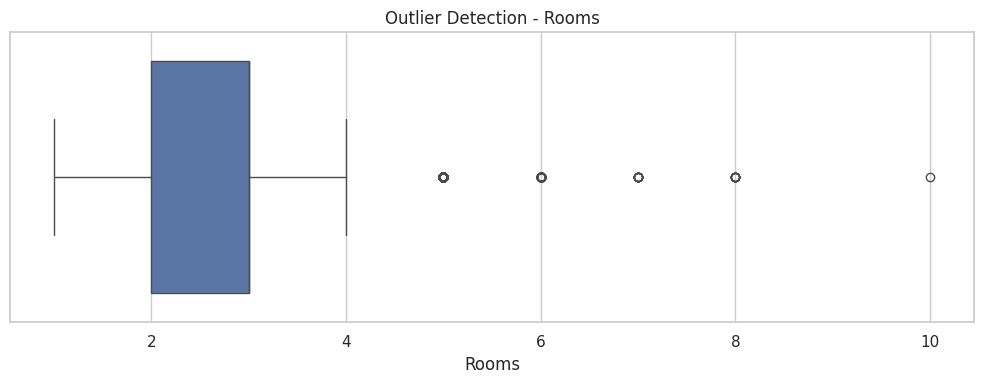

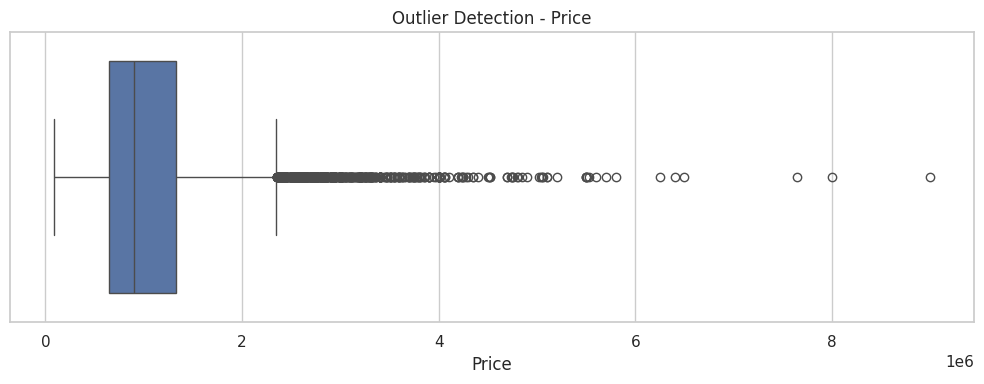

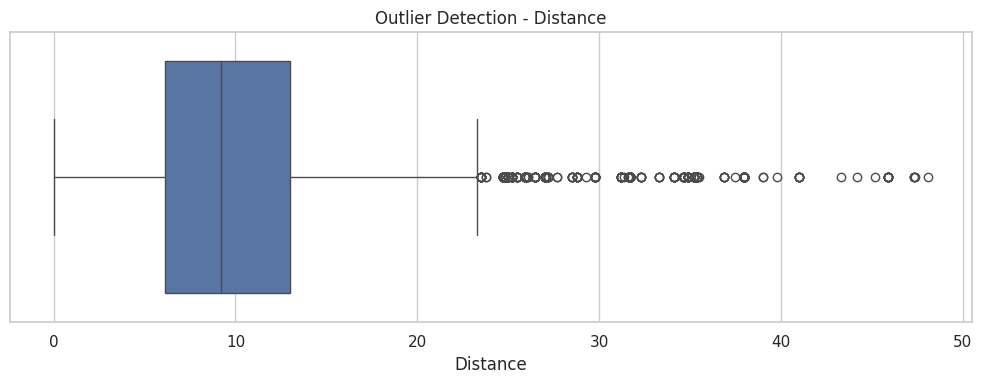

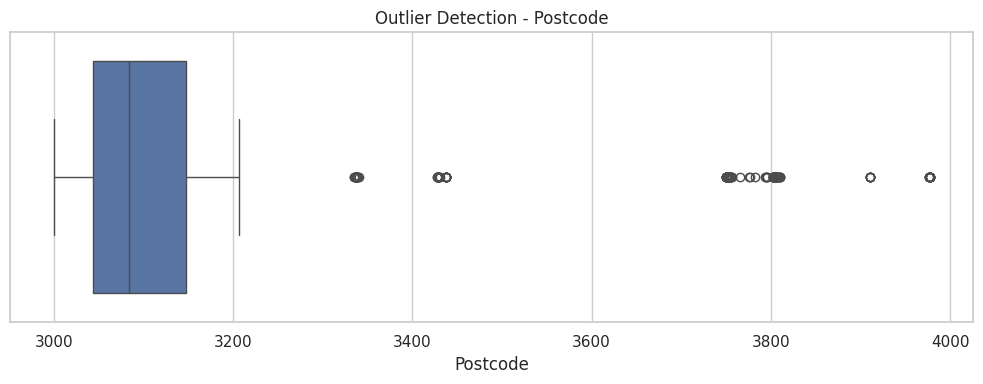

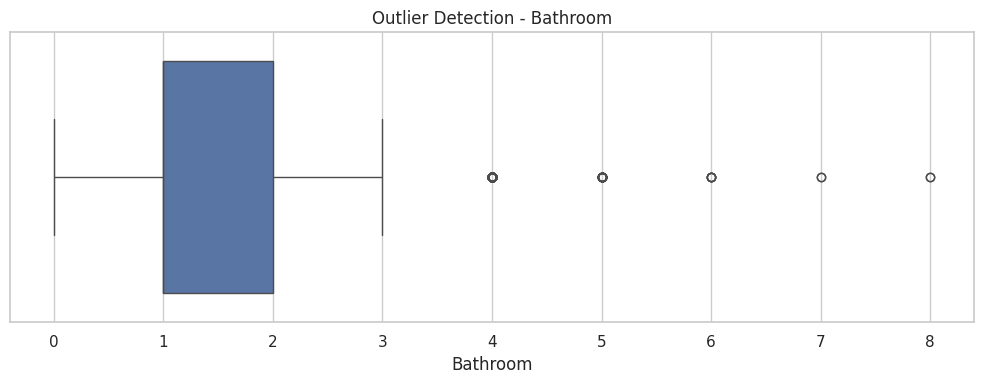

...

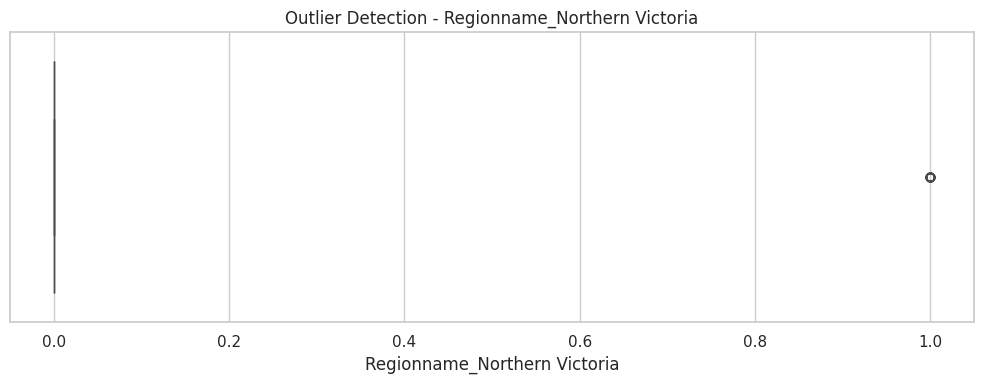

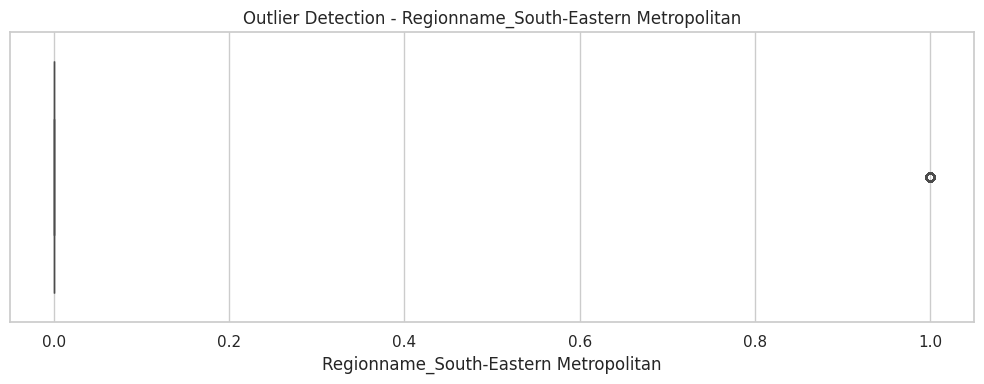

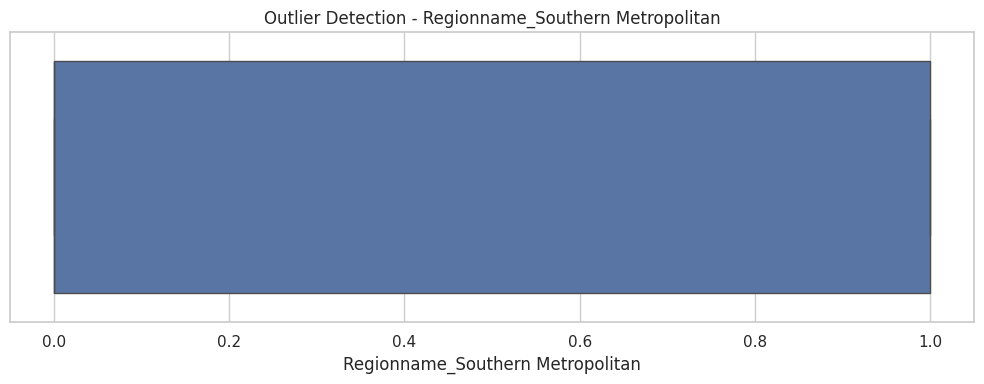

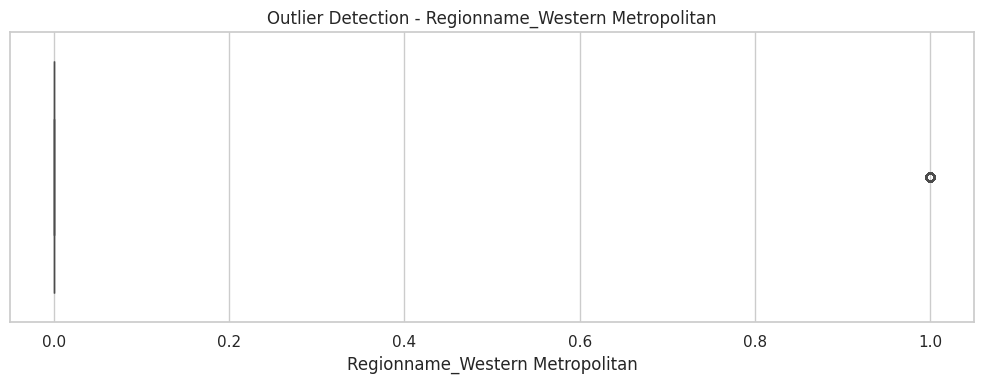

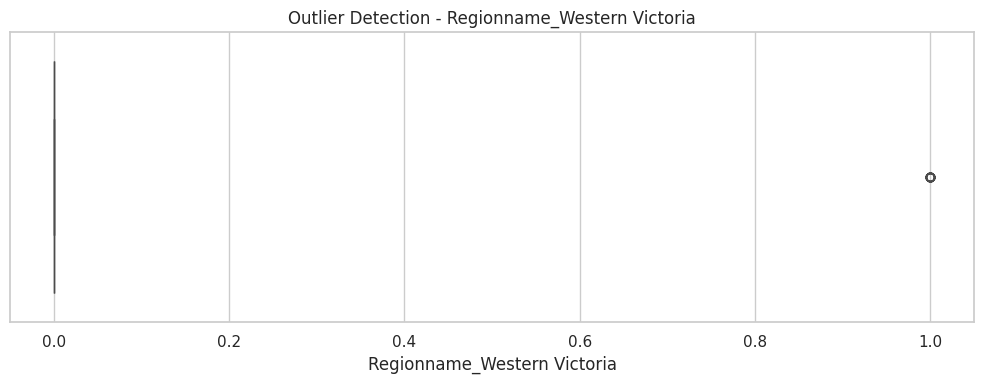

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the cleaned data
df = pd.read_csv('/content/melbourne_processed.csv')  # or use your preferred version

# Optional: create derived column if not already
df['price_per_sqm'] = df['Price'] / df['BuildingArea']

# Set style
sns.set(style="whitegrid")

# List of numerical columns to check
numerical_cols = ['Rooms', 'Price', 'Distance', 'Postcode', 'Bathroom', 'Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude', 'Propertycount', 'Year', 'Month', 'Day', 'DayOfWeek', 'IsWeekend', 'Suburb_Aberfeldie', 'Suburb_Airport West', 'Suburb_Albanvale', 'Suburb_Albert Park', 'Suburb_Albion', 'Suburb_Alphington', 'Suburb_Altona', 'Suburb_Altona Meadows', 'Suburb_Altona North', 'Suburb_Ardeer', 'Suburb_Armadale', 'Suburb_Ascot Vale', 'Suburb_Ashburton', 'Suburb_Ashwood', 'Suburb_Aspendale', 'Suburb_Aspendale Gardens', 'Suburb_Attwood', 'Suburb_Avondale Heights', 'Suburb_Bacchus Marsh', 'Suburb_Balaclava', 'Suburb_Balwyn', 'Suburb_Balwyn North', 'Suburb_Bayswater', 'Suburb_Bayswater North', 'Suburb_Beaconsfield', 'Suburb_Beaconsfield Upper', 'Suburb_Beaumaris', 'Suburb_Bellfield', 'Suburb_Bentleigh', 'Suburb_Bentleigh East', 'Suburb_Berwick', 'Suburb_Black Rock', 'Suburb_Blackburn', 'Suburb_Blackburn North', 'Suburb_Blackburn South', 'Suburb_Bonbeach', 'Suburb_Boronia', 'Suburb_Box Hill', 'Suburb_Braybrook', 'Suburb_Briar Hill', 'Suburb_Brighton', 'Suburb_Brighton East', 'Suburb_Broadmeadows', 'Suburb_Brookfield', 'Suburb_Brooklyn', 'Suburb_Brunswick', 'Suburb_Brunswick East', 'Suburb_Brunswick West', 'Suburb_Bulleen', 'Suburb_Bullengarook', 'Suburb_Bundoora', 'Suburb_Burnley', 'Suburb_Burnside', 'Suburb_Burnside Heights', 'Suburb_Burwood', 'Suburb_Burwood East', 'Suburb_Cairnlea', 'Suburb_Camberwell', 'Suburb_Campbellfield', 'Suburb_Canterbury', 'Suburb_Carlton', 'Suburb_Carlton North', 'Suburb_Carnegie', 'Suburb_Caroline Springs', 'Suburb_Carrum', 'Suburb_Carrum Downs', 'Suburb_Caulfield', 'Suburb_Caulfield East', 'Suburb_Caulfield North', 'Suburb_Caulfield South', 'Suburb_Chadstone', 'Suburb_Chelsea', 'Suburb_Chelsea Heights', 'Suburb_Cheltenham', 'Suburb_Chirnside Park', 'Suburb_Clarinda', 'Suburb_Clayton', 'Suburb_Clayton South', 'Suburb_Clifton Hill', 'Suburb_Coburg', 'Suburb_Coburg North', 'Suburb_Collingwood', 'Suburb_Coolaroo', 'Suburb_Craigieburn', 'Suburb_Cranbourne', 'Suburb_Cranbourne North', 'Suburb_Cremorne', 'Suburb_Croydon', 'Suburb_Croydon Hills', 'Suburb_Croydon North', 'Suburb_Croydon South', 'Suburb_Dallas', 'Suburb_Dandenong', 'Suburb_Dandenong North', 'Suburb_Deepdene', 'Suburb_Deer Park', 'Suburb_Delahey', 'Suburb_Derrimut', 'Suburb_Diamond Creek', 'Suburb_Diggers Rest', 'Suburb_Dingley Village', 'Suburb_Docklands', 'Suburb_Doncaster', 'Suburb_Doncaster East', 'Suburb_Donvale', 'Suburb_Doreen', 'Suburb_Doveton', 'Suburb_Eaglemont', 'Suburb_East Melbourne', 'Suburb_Edithvale', 'Suburb_Elsternwick', 'Suburb_Eltham', 'Suburb_Eltham North', 'Suburb_Elwood', 'Suburb_Emerald', 'Suburb_Endeavour Hills', 'Suburb_Epping', 'Suburb_Essendon', 'Suburb_Essendon North', 'Suburb_Essendon West', 'Suburb_Fairfield', 'Suburb_Fawkner', 'Suburb_Ferntree Gully', 'Suburb_Fitzroy', 'Suburb_Fitzroy North', 'Suburb_Flemington', 'Suburb_Footscray', 'Suburb_Forest Hill', 'Suburb_Frankston', 'Suburb_Frankston North', 'Suburb_Frankston South', 'Suburb_Gardenvale', 'Suburb_Gisborne', 'Suburb_Gladstone Park', 'Suburb_Glen Huntly', 'Suburb_Glen Iris', 'Suburb_Glen Waverley', 'Suburb_Glenroy', 'Suburb_Gowanbrae', 'Suburb_Greensborough', 'Suburb_Greenvale', 'Suburb_Hadfield', 'Suburb_Hallam', 'Suburb_Hampton', 'Suburb_Hampton East', 'Suburb_Hampton Park', 'Suburb_Hawthorn', 'Suburb_Hawthorn East', 'Suburb_Healesville', 'Suburb_Heathmont', 'Suburb_Heidelberg', 'Suburb_Heidelberg Heights', 'Suburb_Heidelberg West', 'Suburb_Highett', 'Suburb_Hillside', 'Suburb_Hoppers Crossing', 'Suburb_Hughesdale', 'Suburb_Huntingdale', 'Suburb_Hurstbridge', 'Suburb_Ivanhoe', 'Suburb_Ivanhoe East', 'Suburb_Jacana', 'Suburb_Kealba', 'Suburb_Keilor', 'Suburb_Keilor Downs', 'Suburb_Keilor East', 'Suburb_Keilor Lodge', 'Suburb_Keilor Park', 'Suburb_Kensington', 'Suburb_Kew', 'Suburb_Kew East', 'Suburb_Keysborough', 'Suburb_Kilsyth', 'Suburb_Kings Park', 'Suburb_Kingsbury', 'Suburb_Kingsville', 'Suburb_Knoxfield', 'Suburb_Kooyong', 'Suburb_Kurunjang', 'Suburb_Lalor', 'Suburb_Langwarrin', 'Suburb_Lower Plenty', 'Suburb_Maidstone', 'Suburb_Malvern', 'Suburb_Malvern East', 'Suburb_Maribyrnong', 'Suburb_McKinnon', 'Suburb_Meadow Heights', 'Suburb_Melbourne', 'Suburb_Melton', 'Suburb_Melton South', 'Suburb_Melton West', 'Suburb_Mentone', 'Suburb_Mernda', 'Suburb_Middle Park', 'Suburb_Mill Park', 'Suburb_Mitcham', 'Suburb_Monbulk', 'Suburb_Mont Albert', 'Suburb_Montmorency', 'Suburb_Montrose', 'Suburb_Moonee Ponds', 'Suburb_Moorabbin', 'Suburb_Mooroolbark', 'Suburb_Mordialloc', 'Suburb_Mount Evelyn', 'Suburb_Mount Waverley', 'Suburb_Mulgrave', 'Suburb_Murrumbeena', 'Suburb_Narre Warren', 'Suburb_New Gisborne', 'Suburb_Newport', 'Suburb_Niddrie', 'Suburb_Noble Park', 'Suburb_North Melbourne', 'Suburb_North Warrandyte', 'Suburb_Northcote', 'Suburb_Notting Hill', 'Suburb_Nunawading', 'Suburb_Oak Park', 'Suburb_Oakleigh', 'Suburb_Oakleigh East', 'Suburb_Oakleigh South', 'Suburb_Officer', 'Suburb_Ormond', 'Suburb_Pakenham', 'Suburb_Parkdale', 'Suburb_Parkville', 'Suburb_Pascoe Vale', 'Suburb_Plumpton', 'Suburb_Point Cook', 'Suburb_Port Melbourne', 'Suburb_Prahran', 'Suburb_Preston', 'Suburb_Princes Hill', 'Suburb_Reservoir', 'Suburb_Richmond', 'Suburb_Riddells Creek', 'Suburb_Ringwood', 'Suburb_Ringwood East', 'Suburb_Ringwood North', 'Suburb_Ripponlea', 'Suburb_Rockbank', 'Suburb_Rosanna', 'Suburb_Rowville', 'Suburb_Roxburgh Park', 'Suburb_Sandhurst', 'Suburb_Sandringham', 'Suburb_Scoresby', 'Suburb_Seabrook', 'Suburb_Seaford', 'Suburb_Seaholme', 'Suburb_Seddon', 'Suburb_Silvan', 'Suburb_Skye', 'Suburb_South Kingsville', 'Suburb_South Melbourne', 'Suburb_South Morang', 'Suburb_South Yarra', 'Suburb_Southbank', 'Suburb_Spotswood', 'Suburb_Springvale', 'Suburb_Springvale South', 'Suburb_St Albans', 'Suburb_St Helena', 'Suburb_St Kilda', 'Suburb_Strathmore', 'Suburb_Strathmore Heights', 'Suburb_Sunbury', 'Suburb_Sunshine', 'Suburb_Sunshine North', 'Suburb_Sunshine West', 'Suburb_Surrey Hills', 'Suburb_Sydenham', 'Suburb_Tarneit', 'Suburb_Taylors Hill', 'Suburb_Taylors Lakes', 'Suburb_Templestowe', 'Suburb_Templestowe Lower', 'Suburb_The Basin', 'Suburb_Thomastown', 'Suburb_Thornbury', 'Suburb_Toorak', 'Suburb_Travancore', 'Suburb_Truganina', 'Suburb_Tullamarine', 'Suburb_Upwey', 'Suburb_Vermont', 'Suburb_Vermont South', 'Suburb_Viewbank', 'Suburb_Wallan', 'Suburb_Wantirna', 'Suburb_Wantirna South', 'Suburb_Warrandyte', 'Suburb_Waterways', 'Suburb_Watsonia', 'Suburb_Watsonia North', 'Suburb_Werribee', 'Suburb_West Footscray', 'Suburb_West Melbourne', 'Suburb_Westmeadows', 'Suburb_Wheelers Hill', 'Suburb_Whittlesea', 'Suburb_Williams Landing', 'Suburb_Williamstown', 'Suburb_Williamstown North', 'Suburb_Windsor', 'Suburb_Wollert', 'Suburb_Wonga Park', 'Suburb_Wyndham Vale', 'Suburb_Yallambie', 'Suburb_Yarra Glen', 'Suburb_Yarraville', 'Type_t', 'Type_u', 'SellerG_ASL', "SellerG_Abercromby's", 'SellerG_Ace', 'SellerG_Alexkarbon', 'SellerG_Allens', 'SellerG_Anderson', 'SellerG_Appleby', 'SellerG_Aquire', 'SellerG_Area', 'SellerG_Ascend', 'SellerG_Ash', 'SellerG_Asset', 'SellerG_Assisi', 'SellerG_Australian', 'SellerG_Barlow', 'SellerG_Barry', 'SellerG_Bayside', 'SellerG_Bekdon', 'SellerG_Beller', 'SellerG_Bells', 'SellerG_Besser', 'SellerG_Better', 'SellerG_Biggin', 'SellerG_Blue', 'SellerG_Boutique', 'SellerG_Bowman', 'SellerG_Brace', 'SellerG_Brad', 'SellerG_Buckingham', 'SellerG_Bullen', 'SellerG_Burnham', 'SellerG_Buxton', 'SellerG_Buxton/Advantage', 'SellerG_Buxton/Find', 'SellerG_C21', 'SellerG_CASTRAN', 'SellerG_Caine', 'SellerG_Calder', 'SellerG_Carter', 'SellerG_Castran', 'SellerG_Cayzer', 'SellerG_Century', 'SellerG_Chambers', 'SellerG_Changing', 'SellerG_Charlton', 'SellerG_Chisholm', 'SellerG_Christopher', 'SellerG_Clairmont', 'SellerG_Collins', 'SellerG_Community', 'SellerG_Compton', 'SellerG_Conquest', 'SellerG_Considine', 'SellerG_Coventry', 'SellerG_Craig', 'SellerG_Crane', "SellerG_D'Aprano", 'SellerG_Daniel', 'SellerG_Darras', 'SellerG_Darren', 'SellerG_David', 'SellerG_Del', 'SellerG_Dingle', 'SellerG_Direct', 'SellerG_Dixon', 'SellerG_Domain', 'SellerG_Douglas', 'SellerG_Edward', 'SellerG_Elite', 'SellerG_Eview', 'SellerG_FN', 'SellerG_First', 'SellerG_Fletchers', 'SellerG_Fletchers/One', 'SellerG_Follett', 'SellerG_Frank', 'SellerG_Free', 'SellerG_GL', 'SellerG_Galldon', 'SellerG_Gardiner', 'SellerG_Garvey', 'SellerG_Gary', 'SellerG_Geoff', 'SellerG_Grantham', 'SellerG_Greg', 'SellerG_Gunn&Co', 'SellerG_HAR', 'SellerG_Hall', 'SellerG_Ham', 'SellerG_Harcourts', 'SellerG_Harrington', 'SellerG_Haughton', 'SellerG_Hayeswinckle', 'SellerG_Hodges', 'SellerG_Holland', 'SellerG_Homes', 'SellerG_Hooper', 'SellerG_Hoskins', 'SellerG_Hunter', 'SellerG_Iconek', 'SellerG_J', 'SellerG_JMRE', 'SellerG_JRW', 'SellerG_Jas', 'SellerG_Jason', 'SellerG_Jellis', 'SellerG_Jim', 'SellerG_Joe', 'SellerG_Johnston', 'SellerG_Joseph', 'SellerG_Kay', 'SellerG_Kaye', 'SellerG_Keatings', 'SellerG_Kelly', 'SellerG_Ken', 'SellerG_L', 'SellerG_LITTLE', 'SellerG_LJ', 'SellerG_LLC', 'SellerG_Langwell', 'SellerG_Le', 'SellerG_Leading', 'SellerG_Leased', 'SellerG_Leeburn', 'SellerG_Leyton', 'SellerG_Lindellas', 'SellerG_Love', 'SellerG_Lucas', 'SellerG_Luxe', 'SellerG_Luxton', 'SellerG_M.J', 'SellerG_MICM', 'SellerG_Maddison', 'SellerG_Mandy', 'SellerG_Marshall', 'SellerG_Mason', 'SellerG_Matthew', 'SellerG_Max', 'SellerG_McDonald', 'SellerG_McGrath', 'SellerG_McLennan', 'SellerG_McNaughton', 'SellerG_Meadows', 'SellerG_Melbourne', 'SellerG_Metro', 'SellerG_Miles', 'SellerG_Millership', 'SellerG_Mindacom', 'SellerG_Mitchell', 'SellerG_Moonee', 'SellerG_Morleys', 'SellerG_Morrison', 'SellerG_Naison', 'SellerG_Nardella', 'SellerG_Nelson', 'SellerG_New', 'SellerG_Nguyen', 'SellerG_Nicholls', 'SellerG_Nicholson', 'SellerG_Nick', 'SellerG_Noel', 'SellerG_North', "SellerG_O'Brien", "SellerG_O'Donoghues", 'SellerG_Oak', 'SellerG_Obrien', 'SellerG_One', 'SellerG_Only', 'SellerG_Oriental', 'SellerG_Owen', 'SellerG_PRD', 'SellerG_PRDNationwide', 'SellerG_Pagan', 'SellerG_Parkes', 'SellerG_Parkinson', 'SellerG_Paul', 'SellerG_Peake', 'SellerG_Peter', 'SellerG_Philip', 'SellerG_Point', 'SellerG_Pride', 'SellerG_Prime', "SellerG_Private/Tiernan's", 'SellerG_Prof.', 'SellerG_Property', 'SellerG_Propertyau', 'SellerG_Prowse', 'SellerG_Purplebricks', 'SellerG_R&H', 'SellerG_RE', 'SellerG_REMAX', 'SellerG_RT', 'SellerG_RW', 'SellerG_Raine', 'SellerG_Raine&Horne', 'SellerG_Ray', 'SellerG_Re', 'SellerG_Reach', 'SellerG_Real', 'SellerG_Red', 'SellerG_Redina', 'SellerG_Reed', 'SellerG_Reliance', 'SellerG_Rendina', 'SellerG_Rexhepi', 'SellerG_Ristic', 'SellerG_Rodney', 'SellerG_Roger', 'SellerG_Rosin', 'SellerG_Ross', 'SellerG_Rounds', 'SellerG_Ryder', 'SellerG_S&L', 'SellerG_SN', 'SellerG_Schroeder', 'SellerG_Scott', 'SellerG_Sell', 'SellerG_Smart', "SellerG_Sotheby's", 'SellerG_Steveway', 'SellerG_Stockdale', 'SellerG_Sweeney', 'SellerG_Sweeney/Advantage', 'SellerG_TRUE', 'SellerG_The', 'SellerG_Thomas', 'SellerG_Thomson', "SellerG_Tiernan's", 'SellerG_Tim', 'SellerG_Trimson', 'SellerG_Triwest', 'SellerG_U', 'SellerG_Upper', 'SellerG_VICPROP', 'SellerG_VICProp', 'SellerG_Veitch', 'SellerG_Vic', 'SellerG_Victory', 'SellerG_Village', 'SellerG_W.B.', 'SellerG_WHITEFOX', 'SellerG_Walsh', 'SellerG_Walshe', 'SellerG_Weast', 'SellerG_Weda', 'SellerG_Weston', 'SellerG_Westside', 'SellerG_White', 'SellerG_Whiting', 'SellerG_William', 'SellerG_Williams', 'SellerG_Wilson', 'SellerG_Win', 'SellerG_Wood', 'SellerG_Woodards', 'SellerG_Xynergy', 'SellerG_YPA', 'SellerG_Zahn', 'SellerG_buyMyplace', 'SellerG_hockingstuart', 'SellerG_hockingstuart/Advantage', 'SellerG_hockingstuart/Barry', 'SellerG_hockingstuart/Village', 'SellerG_iOne', 'SellerG_iProperty', 'SellerG_iSell', 'SellerG_iTRAK', 'CouncilArea_Bayside', 'CouncilArea_Boroondara', 'CouncilArea_Brimbank', 'CouncilArea_Cardinia', 'CouncilArea_Casey', 'CouncilArea_Darebin', 'CouncilArea_Frankston', 'CouncilArea_Glen Eira', 'CouncilArea_Greater Dandenong', 'CouncilArea_Hobsons Bay', 'CouncilArea_Hume', 'CouncilArea_Kingston', 'CouncilArea_Knox', 'CouncilArea_Macedon Ranges', 'CouncilArea_Manningham', 'CouncilArea_Maribyrnong', 'CouncilArea_Maroondah', 'CouncilArea_Melbourne', 'CouncilArea_Melton', 'CouncilArea_Monash', 'CouncilArea_Moonee Valley', 'CouncilArea_Moorabool', 'CouncilArea_Moreland', 'CouncilArea_Nillumbik', 'CouncilArea_Port Phillip', 'CouncilArea_Stonnington', 'CouncilArea_Unavailable', 'CouncilArea_Whitehorse', 'CouncilArea_Whittlesea', 'CouncilArea_Wyndham', 'CouncilArea_Yarra', 'CouncilArea_Yarra Ranges', 'Regionname_Eastern Victoria', 'Regionname_Northern Metropolitan', 'Regionname_Northern Victoria', 'Regionname_South-Eastern Metropolitan', 'Regionname_Southern Metropolitan', 'Regionname_Western Metropolitan', 'Regionname_Western Victoria']

# Plot Boxplots for Outlier Detection
for col in numerical_cols:
    plt.figure(figsize=(10, 4))
    sns.boxplot(x=df[col])
    plt.title(f"Outlier Detection - {col}")
    plt.xlabel(col)
    plt.tight_layout()
    plt.show()

# plotes

In [ ]:
import pandas as pd
import plotly.express as px

# Load all 3 treated datasets
df_mean = pd.read_csv("/content/melbourne_mean_imputed.csv")
df_median = pd.read_csv("/content/melbourne_median_imputed.csv")
df_knn = pd.read_csv("/content/melbourne_knn_imputed.csv")

# Optional: create derived column if not present
for df in [df_mean, df_median, df_knn]:
    df['price_per_sqm'] = df['Price'] / df['BuildingArea']

# 1. Price Distribution
px.histogram(df_mean, x='Price', nbins=50, title="Price Distribution (Mean Imputed)").show()
px.histogram(df_median, x='Price', nbins=50, title="Price Distribution (Median Imputed)").show()
px.histogram(df_knn, x='Price', nbins=50, title="Price Distribution (KNN Imputed)").show()

# 2. Rooms vs Price
px.box(df_knn, x='Rooms', y='Price', title="Price vs Number of Rooms").show()



# 7. Price per SqM Histogram
px.histogram(df_knn, x='price_per_sqm', nbins=50, title="Price per Square Meter (KNN Imputed)").show()

# 4: Remove outliers


In [ ]:
import pandas as pd

# Load original (already imputed) datasets
df_mean = pd.read_csv("/content/melbourne_mean_imputed.csv")
df_median = pd.read_csv("/content/melbourne_median_imputed.csv")
df_knn = pd.read_csv("/content/melbourne_knn_imputed.csv")

# List of numeric columns for outlier treatment
numeric_cols = ['Rooms', 'Price', 'Distance', 'Postcode', 'Bathroom', 'Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude', 'Propertycount', 'Year', 'Month', 'Day', 'DayOfWeek', 'IsWeekend', 'Suburb_Aberfeldie', 'Suburb_Airport West', 'Suburb_Albanvale', 'Suburb_Albert Park', 'Suburb_Albion', 'Suburb_Alphington', 'Suburb_Altona', 'Suburb_Altona Meadows', 'Suburb_Altona North', 'Suburb_Ardeer', 'Suburb_Armadale', 'Suburb_Ascot Vale', 'Suburb_Ashburton', 'Suburb_Ashwood', 'Suburb_Aspendale', 'Suburb_Aspendale Gardens', 'Suburb_Attwood', 'Suburb_Avondale Heights', 'Suburb_Bacchus Marsh', 'Suburb_Balaclava', 'Suburb_Balwyn', 'Suburb_Balwyn North', 'Suburb_Bayswater', 'Suburb_Bayswater North', 'Suburb_Beaconsfield', 'Suburb_Beaconsfield Upper', 'Suburb_Beaumaris', 'Suburb_Bellfield', 'Suburb_Bentleigh', 'Suburb_Bentleigh East', 'Suburb_Berwick', 'Suburb_Black Rock', 'Suburb_Blackburn', 'Suburb_Blackburn North', 'Suburb_Blackburn South', 'Suburb_Bonbeach', 'Suburb_Boronia', 'Suburb_Box Hill', 'Suburb_Braybrook', 'Suburb_Briar Hill', 'Suburb_Brighton', 'Suburb_Brighton East', 'Suburb_Broadmeadows', 'Suburb_Brookfield', 'Suburb_Brooklyn', 'Suburb_Brunswick', 'Suburb_Brunswick East', 'Suburb_Brunswick West', 'Suburb_Bulleen', 'Suburb_Bullengarook', 'Suburb_Bundoora', 'Suburb_Burnley', 'Suburb_Burnside', 'Suburb_Burnside Heights', 'Suburb_Burwood', 'Suburb_Burwood East', 'Suburb_Cairnlea', 'Suburb_Camberwell', 'Suburb_Campbellfield', 'Suburb_Canterbury', 'Suburb_Carlton', 'Suburb_Carlton North', 'Suburb_Carnegie', 'Suburb_Caroline Springs', 'Suburb_Carrum', 'Suburb_Carrum Downs', 'Suburb_Caulfield', 'Suburb_Caulfield East', 'Suburb_Caulfield North', 'Suburb_Caulfield South', 'Suburb_Chadstone', 'Suburb_Chelsea', 'Suburb_Chelsea Heights', 'Suburb_Cheltenham', 'Suburb_Chirnside Park', 'Suburb_Clarinda', 'Suburb_Clayton', 'Suburb_Clayton South', 'Suburb_Clifton Hill', 'Suburb_Coburg', 'Suburb_Coburg North', 'Suburb_Collingwood', 'Suburb_Coolaroo', 'Suburb_Craigieburn', 'Suburb_Cranbourne', 'Suburb_Cranbourne North', 'Suburb_Cremorne', 'Suburb_Croydon', 'Suburb_Croydon Hills', 'Suburb_Croydon North', 'Suburb_Croydon South', 'Suburb_Dallas', 'Suburb_Dandenong', 'Suburb_Dandenong North', 'Suburb_Deepdene', 'Suburb_Deer Park', 'Suburb_Delahey', 'Suburb_Derrimut', 'Suburb_Diamond Creek', 'Suburb_Diggers Rest', 'Suburb_Dingley Village', 'Suburb_Docklands', 'Suburb_Doncaster', 'Suburb_Doncaster East', 'Suburb_Donvale', 'Suburb_Doreen', 'Suburb_Doveton', 'Suburb_Eaglemont', 'Suburb_East Melbourne', 'Suburb_Edithvale', 'Suburb_Elsternwick', 'Suburb_Eltham', 'Suburb_Eltham North', 'Suburb_Elwood', 'Suburb_Emerald', 'Suburb_Endeavour Hills', 'Suburb_Epping', 'Suburb_Essendon', 'Suburb_Essendon North', 'Suburb_Essendon West', 'Suburb_Fairfield', 'Suburb_Fawkner', 'Suburb_Ferntree Gully', 'Suburb_Fitzroy', 'Suburb_Fitzroy North', 'Suburb_Flemington', 'Suburb_Footscray', 'Suburb_Forest Hill', 'Suburb_Frankston', 'Suburb_Frankston North', 'Suburb_Frankston South', 'Suburb_Gardenvale', 'Suburb_Gisborne', 'Suburb_Gladstone Park', 'Suburb_Glen Huntly', 'Suburb_Glen Iris', 'Suburb_Glen Waverley', 'Suburb_Glenroy', 'Suburb_Gowanbrae', 'Suburb_Greensborough', 'Suburb_Greenvale', 'Suburb_Hadfield', 'Suburb_Hallam', 'Suburb_Hampton', 'Suburb_Hampton East', 'Suburb_Hampton Park', 'Suburb_Hawthorn', 'Suburb_Hawthorn East', 'Suburb_Healesville', 'Suburb_Heathmont', 'Suburb_Heidelberg', 'Suburb_Heidelberg Heights', 'Suburb_Heidelberg West', 'Suburb_Highett', 'Suburb_Hillside', 'Suburb_Hoppers Crossing', 'Suburb_Hughesdale', 'Suburb_Huntingdale', 'Suburb_Hurstbridge', 'Suburb_Ivanhoe', 'Suburb_Ivanhoe East', 'Suburb_Jacana', 'Suburb_Kealba', 'Suburb_Keilor', 'Suburb_Keilor Downs', 'Suburb_Keilor East', 'Suburb_Keilor Lodge', 'Suburb_Keilor Park', 'Suburb_Kensington', 'Suburb_Kew', 'Suburb_Kew East', 'Suburb_Keysborough', 'Suburb_Kilsyth', 'Suburb_Kings Park', 'Suburb_Kingsbury', 'Suburb_Kingsville', 'Suburb_Knoxfield', 'Suburb_Kooyong', 'Suburb_Kurunjang', 'Suburb_Lalor', 'Suburb_Langwarrin', 'Suburb_Lower Plenty', 'Suburb_Maidstone', 'Suburb_Malvern', 'Suburb_Malvern East', 'Suburb_Maribyrnong', 'Suburb_McKinnon', 'Suburb_Meadow Heights', 'Suburb_Melbourne', 'Suburb_Melton', 'Suburb_Melton South', 'Suburb_Melton West', 'Suburb_Mentone', 'Suburb_Mernda', 'Suburb_Middle Park', 'Suburb_Mill Park', 'Suburb_Mitcham', 'Suburb_Monbulk', 'Suburb_Mont Albert', 'Suburb_Montmorency', 'Suburb_Montrose', 'Suburb_Moonee Ponds', 'Suburb_Moorabbin', 'Suburb_Mooroolbark', 'Suburb_Mordialloc', 'Suburb_Mount Evelyn', 'Suburb_Mount Waverley', 'Suburb_Mulgrave', 'Suburb_Murrumbeena', 'Suburb_Narre Warren', 'Suburb_New Gisborne', 'Suburb_Newport', 'Suburb_Niddrie', 'Suburb_Noble Park', 'Suburb_North Melbourne', 'Suburb_North Warrandyte', 'Suburb_Northcote', 'Suburb_Notting Hill', 'Suburb_Nunawading', 'Suburb_Oak Park', 'Suburb_Oakleigh', 'Suburb_Oakleigh East', 'Suburb_Oakleigh South', 'Suburb_Officer', 'Suburb_Ormond', 'Suburb_Pakenham', 'Suburb_Parkdale', 'Suburb_Parkville', 'Suburb_Pascoe Vale', 'Suburb_Plumpton', 'Suburb_Point Cook', 'Suburb_Port Melbourne', 'Suburb_Prahran', 'Suburb_Preston', 'Suburb_Princes Hill', 'Suburb_Reservoir', 'Suburb_Richmond', 'Suburb_Riddells Creek', 'Suburb_Ringwood', 'Suburb_Ringwood East', 'Suburb_Ringwood North', 'Suburb_Ripponlea', 'Suburb_Rockbank', 'Suburb_Rosanna', 'Suburb_Rowville', 'Suburb_Roxburgh Park', 'Suburb_Sandhurst', 'Suburb_Sandringham', 'Suburb_Scoresby', 'Suburb_Seabrook', 'Suburb_Seaford', 'Suburb_Seaholme', 'Suburb_Seddon', 'Suburb_Silvan', 'Suburb_Skye', 'Suburb_South Kingsville', 'Suburb_South Melbourne', 'Suburb_South Morang', 'Suburb_South Yarra', 'Suburb_Southbank', 'Suburb_Spotswood', 'Suburb_Springvale', 'Suburb_Springvale South', 'Suburb_St Albans', 'Suburb_St Helena', 'Suburb_St Kilda', 'Suburb_Strathmore', 'Suburb_Strathmore Heights', 'Suburb_Sunbury', 'Suburb_Sunshine', 'Suburb_Sunshine North', 'Suburb_Sunshine West', 'Suburb_Surrey Hills', 'Suburb_Sydenham', 'Suburb_Tarneit', 'Suburb_Taylors Hill', 'Suburb_Taylors Lakes', 'Suburb_Templestowe', 'Suburb_Templestowe Lower', 'Suburb_The Basin', 'Suburb_Thomastown', 'Suburb_Thornbury', 'Suburb_Toorak', 'Suburb_Travancore', 'Suburb_Truganina', 'Suburb_Tullamarine', 'Suburb_Upwey', 'Suburb_Vermont', 'Suburb_Vermont South', 'Suburb_Viewbank', 'Suburb_Wallan', 'Suburb_Wantirna', 'Suburb_Wantirna South', 'Suburb_Warrandyte', 'Suburb_Waterways', 'Suburb_Watsonia', 'Suburb_Watsonia North', 'Suburb_Werribee', 'Suburb_West Footscray', 'Suburb_West Melbourne', 'Suburb_Westmeadows', 'Suburb_Wheelers Hill', 'Suburb_Whittlesea', 'Suburb_Williams Landing', 'Suburb_Williamstown', 'Suburb_Williamstown North', 'Suburb_Windsor', 'Suburb_Wollert', 'Suburb_Wonga Park', 'Suburb_Wyndham Vale', 'Suburb_Yallambie', 'Suburb_Yarra Glen', 'Suburb_Yarraville', 'Type_t', 'Type_u', 'SellerG_ASL', "SellerG_Abercromby's", 'SellerG_Ace', 'SellerG_Alexkarbon', 'SellerG_Allens', 'SellerG_Anderson', 'SellerG_Appleby', 'SellerG_Aquire', 'SellerG_Area', 'SellerG_Ascend', 'SellerG_Ash', 'SellerG_Asset', 'SellerG_Assisi', 'SellerG_Australian', 'SellerG_Barlow', 'SellerG_Barry', 'SellerG_Bayside', 'SellerG_Bekdon', 'SellerG_Beller', 'SellerG_Bells', 'SellerG_Besser', 'SellerG_Better', 'SellerG_Biggin', 'SellerG_Blue', 'SellerG_Boutique', 'SellerG_Bowman', 'SellerG_Brace', 'SellerG_Brad', 'SellerG_Buckingham', 'SellerG_Bullen', 'SellerG_Burnham', 'SellerG_Buxton', 'SellerG_Buxton/Advantage', 'SellerG_Buxton/Find', 'SellerG_C21', 'SellerG_CASTRAN', 'SellerG_Caine', 'SellerG_Calder', 'SellerG_Carter', 'SellerG_Castran', 'SellerG_Cayzer', 'SellerG_Century', 'SellerG_Chambers', 'SellerG_Changing', 'SellerG_Charlton', 'SellerG_Chisholm', 'SellerG_Christopher', 'SellerG_Clairmont', 'SellerG_Collins', 'SellerG_Community', 'SellerG_Compton', 'SellerG_Conquest', 'SellerG_Considine', 'SellerG_Coventry', 'SellerG_Craig', 'SellerG_Crane', "SellerG_D'Aprano", 'SellerG_Daniel', 'SellerG_Darras', 'SellerG_Darren', 'SellerG_David', 'SellerG_Del', 'SellerG_Dingle', 'SellerG_Direct', 'SellerG_Dixon', 'SellerG_Domain', 'SellerG_Douglas', 'SellerG_Edward', 'SellerG_Elite', 'SellerG_Eview', 'SellerG_FN', 'SellerG_First', 'SellerG_Fletchers', 'SellerG_Fletchers/One', 'SellerG_Follett', 'SellerG_Frank', 'SellerG_Free', 'SellerG_GL', 'SellerG_Galldon', 'SellerG_Gardiner', 'SellerG_Garvey', 'SellerG_Gary', 'SellerG_Geoff', 'SellerG_Grantham', 'SellerG_Greg', 'SellerG_Gunn&Co', 'SellerG_HAR', 'SellerG_Hall', 'SellerG_Ham', 'SellerG_Harcourts', 'SellerG_Harrington', 'SellerG_Haughton', 'SellerG_Hayeswinckle', 'SellerG_Hodges', 'SellerG_Holland', 'SellerG_Homes', 'SellerG_Hooper', 'SellerG_Hoskins', 'SellerG_Hunter', 'SellerG_Iconek', 'SellerG_J', 'SellerG_JMRE', 'SellerG_JRW', 'SellerG_Jas', 'SellerG_Jason', 'SellerG_Jellis', 'SellerG_Jim', 'SellerG_Joe', 'SellerG_Johnston', 'SellerG_Joseph', 'SellerG_Kay', 'SellerG_Kaye', 'SellerG_Keatings', 'SellerG_Kelly', 'SellerG_Ken', 'SellerG_L', 'SellerG_LITTLE', 'SellerG_LJ', 'SellerG_LLC', 'SellerG_Langwell', 'SellerG_Le', 'SellerG_Leading', 'SellerG_Leased', 'SellerG_Leeburn', 'SellerG_Leyton', 'SellerG_Lindellas', 'SellerG_Love', 'SellerG_Lucas', 'SellerG_Luxe', 'SellerG_Luxton', 'SellerG_M.J', 'SellerG_MICM', 'SellerG_Maddison', 'SellerG_Mandy', 'SellerG_Marshall', 'SellerG_Mason', 'SellerG_Matthew', 'SellerG_Max', 'SellerG_McDonald', 'SellerG_McGrath', 'SellerG_McLennan', 'SellerG_McNaughton', 'SellerG_Meadows', 'SellerG_Melbourne', 'SellerG_Metro', 'SellerG_Miles', 'SellerG_Millership', 'SellerG_Mindacom', 'SellerG_Mitchell', 'SellerG_Moonee', 'SellerG_Morleys', 'SellerG_Morrison', 'SellerG_Naison', 'SellerG_Nardella', 'SellerG_Nelson', 'SellerG_New', 'SellerG_Nguyen', 'SellerG_Nicholls', 'SellerG_Nicholson', 'SellerG_Nick', 'SellerG_Noel', 'SellerG_North', "SellerG_O'Brien", "SellerG_O'Donoghues", 'SellerG_Oak', 'SellerG_Obrien', 'SellerG_One', 'SellerG_Only', 'SellerG_Oriental', 'SellerG_Owen', 'SellerG_PRD', 'SellerG_PRDNationwide', 'SellerG_Pagan', 'SellerG_Parkes', 'SellerG_Parkinson', 'SellerG_Paul', 'SellerG_Peake', 'SellerG_Peter', 'SellerG_Philip', 'SellerG_Point', 'SellerG_Pride', 'SellerG_Prime', "SellerG_Private/Tiernan's", 'SellerG_Prof.', 'SellerG_Property', 'SellerG_Propertyau', 'SellerG_Prowse', 'SellerG_Purplebricks', 'SellerG_R&H', 'SellerG_RE', 'SellerG_REMAX', 'SellerG_RT', 'SellerG_RW', 'SellerG_Raine', 'SellerG_Raine&Horne', 'SellerG_Ray', 'SellerG_Re', 'SellerG_Reach', 'SellerG_Real', 'SellerG_Red', 'SellerG_Redina', 'SellerG_Reed', 'SellerG_Reliance', 'SellerG_Rendina', 'SellerG_Rexhepi', 'SellerG_Ristic', 'SellerG_Rodney', 'SellerG_Roger', 'SellerG_Rosin', 'SellerG_Ross', 'SellerG_Rounds', 'SellerG_Ryder', 'SellerG_S&L', 'SellerG_SN', 'SellerG_Schroeder', 'SellerG_Scott', 'SellerG_Sell', 'SellerG_Smart', "SellerG_Sotheby's", 'SellerG_Steveway', 'SellerG_Stockdale', 'SellerG_Sweeney', 'SellerG_Sweeney/Advantage', 'SellerG_TRUE', 'SellerG_The', 'SellerG_Thomas', 'SellerG_Thomson', "SellerG_Tiernan's", 'SellerG_Tim', 'SellerG_Trimson', 'SellerG_Triwest', 'SellerG_U', 'SellerG_Upper', 'SellerG_VICPROP', 'SellerG_VICProp', 'SellerG_Veitch', 'SellerG_Vic', 'SellerG_Victory', 'SellerG_Village', 'SellerG_W.B.', 'SellerG_WHITEFOX', 'SellerG_Walsh', 'SellerG_Walshe', 'SellerG_Weast', 'SellerG_Weda', 'SellerG_Weston', 'SellerG_Westside', 'SellerG_White', 'SellerG_Whiting', 'SellerG_William', 'SellerG_Williams', 'SellerG_Wilson', 'SellerG_Win', 'SellerG_Wood', 'SellerG_Woodards', 'SellerG_Xynergy', 'SellerG_YPA', 'SellerG_Zahn', 'SellerG_buyMyplace', 'SellerG_hockingstuart', 'SellerG_hockingstuart/Advantage', 'SellerG_hockingstuart/Barry', 'SellerG_hockingstuart/Village', 'SellerG_iOne', 'SellerG_iProperty', 'SellerG_iSell', 'SellerG_iTRAK', 'CouncilArea_Bayside', 'CouncilArea_Boroondara', 'CouncilArea_Brimbank', 'CouncilArea_Cardinia', 'CouncilArea_Casey', 'CouncilArea_Darebin', 'CouncilArea_Frankston', 'CouncilArea_Glen Eira', 'CouncilArea_Greater Dandenong', 'CouncilArea_Hobsons Bay', 'CouncilArea_Hume', 'CouncilArea_Kingston', 'CouncilArea_Knox', 'CouncilArea_Macedon Ranges', 'CouncilArea_Manningham', 'CouncilArea_Maribyrnong', 'CouncilArea_Maroondah', 'CouncilArea_Melbourne', 'CouncilArea_Melton', 'CouncilArea_Monash', 'CouncilArea_Moonee Valley', 'CouncilArea_Moorabool', 'CouncilArea_Moreland', 'CouncilArea_Nillumbik', 'CouncilArea_Port Phillip', 'CouncilArea_Stonnington', 'CouncilArea_Unavailable', 'CouncilArea_Whitehorse', 'CouncilArea_Whittlesea', 'CouncilArea_Wyndham', 'CouncilArea_Yarra', 'CouncilArea_Yarra Ranges', 'Regionname_Eastern Victoria', 'Regionname_Northern Metropolitan', 'Regionname_Northern Victoria', 'Regionname_South-Eastern Metropolitan', 'Regionname_Southern Metropolitan', 'Regionname_Western Metropolitan', 'Regionname_Western Victoria']


def treat_outliers_iqr(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Cap the outliers
    data[column] = data[column].apply(lambda x: upper_bound if x > upper_bound else (lower_bound if x < lower_bound else x))
    return data

# Apply to numeric columns
numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns

for col in numeric_cols:
    df = treat_outliers_iqr(df, col)

# Create treated copies
df_mean_treated = df_mean.copy()
df_median_treated = df_median.copy()
df_knn_treated = df_knn.copy()
df_mean.to_csv("df_mean_treated.csv", index=False)
df_median.to_csv("df_median_treated.csv", index=False)
df_knn.to_csv("df_knn_treated.csv", index=False)





# 5: Apply scalling on Data

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler

# List of filenames for the 6 datasets
file_paths = {
    "mean_original": "/content/melbourne_mean_imputed.csv",
    "median_original": "/content/melbourne_median_imputed.csv",
    "knn_original": "/content/melbourne_knn_imputed.csv",
    "mean_treated": "/content/df_mean_treated.csv",
    "median_treated": "/content/df_median_treated.csv",
    "knn_treated": "/content/df_knn_treated.csv"
}

# Columns to scale
numeric_cols = ['Rooms', 'Price', 'Distance', 'Postcode', 'Bathroom', 'Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude', 'Propertycount', 'Year', 'Month', 'Day', 'DayOfWeek', 'IsWeekend', 'Suburb_Aberfeldie', 'Suburb_Airport West', 'Suburb_Albanvale', 'Suburb_Albert Park', 'Suburb_Albion', 'Suburb_Alphington', 'Suburb_Altona', 'Suburb_Altona Meadows', 'Suburb_Altona North', 'Suburb_Ardeer', 'Suburb_Armadale', 'Suburb_Ascot Vale', 'Suburb_Ashburton', 'Suburb_Ashwood', 'Suburb_Aspendale', 'Suburb_Aspendale Gardens', 'Suburb_Attwood', 'Suburb_Avondale Heights', 'Suburb_Bacchus Marsh', 'Suburb_Balaclava', 'Suburb_Balwyn', 'Suburb_Balwyn North', 'Suburb_Bayswater', 'Suburb_Bayswater North', 'Suburb_Beaconsfield', 'Suburb_Beaconsfield Upper', 'Suburb_Beaumaris', 'Suburb_Bellfield', 'Suburb_Bentleigh', 'Suburb_Bentleigh East', 'Suburb_Berwick', 'Suburb_Black Rock', 'Suburb_Blackburn', 'Suburb_Blackburn North', 'Suburb_Blackburn South', 'Suburb_Bonbeach', 'Suburb_Boronia', 'Suburb_Box Hill', 'Suburb_Braybrook', 'Suburb_Briar Hill', 'Suburb_Brighton', 'Suburb_Brighton East', 'Suburb_Broadmeadows', 'Suburb_Brookfield', 'Suburb_Brooklyn', 'Suburb_Brunswick', 'Suburb_Brunswick East', 'Suburb_Brunswick West', 'Suburb_Bulleen', 'Suburb_Bullengarook', 'Suburb_Bundoora', 'Suburb_Burnley', 'Suburb_Burnside', 'Suburb_Burnside Heights', 'Suburb_Burwood', 'Suburb_Burwood East', 'Suburb_Cairnlea', 'Suburb_Camberwell', 'Suburb_Campbellfield', 'Suburb_Canterbury', 'Suburb_Carlton', 'Suburb_Carlton North', 'Suburb_Carnegie', 'Suburb_Caroline Springs', 'Suburb_Carrum', 'Suburb_Carrum Downs', 'Suburb_Caulfield', 'Suburb_Caulfield East', 'Suburb_Caulfield North', 'Suburb_Caulfield South', 'Suburb_Chadstone', 'Suburb_Chelsea', 'Suburb_Chelsea Heights', 'Suburb_Cheltenham', 'Suburb_Chirnside Park', 'Suburb_Clarinda', 'Suburb_Clayton', 'Suburb_Clayton South', 'Suburb_Clifton Hill', 'Suburb_Coburg', 'Suburb_Coburg North', 'Suburb_Collingwood', 'Suburb_Coolaroo', 'Suburb_Craigieburn', 'Suburb_Cranbourne', 'Suburb_Cranbourne North', 'Suburb_Cremorne', 'Suburb_Croydon', 'Suburb_Croydon Hills', 'Suburb_Croydon North', 'Suburb_Croydon South', 'Suburb_Dallas', 'Suburb_Dandenong', 'Suburb_Dandenong North', 'Suburb_Deepdene', 'Suburb_Deer Park', 'Suburb_Delahey', 'Suburb_Derrimut', 'Suburb_Diamond Creek', 'Suburb_Diggers Rest', 'Suburb_Dingley Village', 'Suburb_Docklands', 'Suburb_Doncaster', 'Suburb_Doncaster East', 'Suburb_Donvale', 'Suburb_Doreen', 'Suburb_Doveton', 'Suburb_Eaglemont', 'Suburb_East Melbourne', 'Suburb_Edithvale', 'Suburb_Elsternwick', 'Suburb_Eltham', 'Suburb_Eltham North', 'Suburb_Elwood', 'Suburb_Emerald', 'Suburb_Endeavour Hills', 'Suburb_Epping', 'Suburb_Essendon', 'Suburb_Essendon North', 'Suburb_Essendon West', 'Suburb_Fairfield', 'Suburb_Fawkner', 'Suburb_Ferntree Gully', 'Suburb_Fitzroy', 'Suburb_Fitzroy North', 'Suburb_Flemington', 'Suburb_Footscray', 'Suburb_Forest Hill', 'Suburb_Frankston', 'Suburb_Frankston North', 'Suburb_Frankston South', 'Suburb_Gardenvale', 'Suburb_Gisborne', 'Suburb_Gladstone Park', 'Suburb_Glen Huntly', 'Suburb_Glen Iris', 'Suburb_Glen Waverley', 'Suburb_Glenroy', 'Suburb_Gowanbrae', 'Suburb_Greensborough', 'Suburb_Greenvale', 'Suburb_Hadfield', 'Suburb_Hallam', 'Suburb_Hampton', 'Suburb_Hampton East', 'Suburb_Hampton Park', 'Suburb_Hawthorn', 'Suburb_Hawthorn East', 'Suburb_Healesville', 'Suburb_Heathmont', 'Suburb_Heidelberg', 'Suburb_Heidelberg Heights', 'Suburb_Heidelberg West', 'Suburb_Highett', 'Suburb_Hillside', 'Suburb_Hoppers Crossing', 'Suburb_Hughesdale', 'Suburb_Huntingdale', 'Suburb_Hurstbridge', 'Suburb_Ivanhoe', 'Suburb_Ivanhoe East', 'Suburb_Jacana', 'Suburb_Kealba', 'Suburb_Keilor', 'Suburb_Keilor Downs', 'Suburb_Keilor East', 'Suburb_Keilor Lodge', 'Suburb_Keilor Park', 'Suburb_Kensington', 'Suburb_Kew', 'Suburb_Kew East', 'Suburb_Keysborough', 'Suburb_Kilsyth', 'Suburb_Kings Park', 'Suburb_Kingsbury', 'Suburb_Kingsville', 'Suburb_Knoxfield', 'Suburb_Kooyong', 'Suburb_Kurunjang', 'Suburb_Lalor', 'Suburb_Langwarrin', 'Suburb_Lower Plenty', 'Suburb_Maidstone', 'Suburb_Malvern', 'Suburb_Malvern East', 'Suburb_Maribyrnong', 'Suburb_McKinnon', 'Suburb_Meadow Heights', 'Suburb_Melbourne', 'Suburb_Melton', 'Suburb_Melton South', 'Suburb_Melton West', 'Suburb_Mentone', 'Suburb_Mernda', 'Suburb_Middle Park', 'Suburb_Mill Park', 'Suburb_Mitcham', 'Suburb_Monbulk', 'Suburb_Mont Albert', 'Suburb_Montmorency', 'Suburb_Montrose', 'Suburb_Moonee Ponds', 'Suburb_Moorabbin', 'Suburb_Mooroolbark', 'Suburb_Mordialloc', 'Suburb_Mount Evelyn', 'Suburb_Mount Waverley', 'Suburb_Mulgrave', 'Suburb_Murrumbeena', 'Suburb_Narre Warren', 'Suburb_New Gisborne', 'Suburb_Newport', 'Suburb_Niddrie', 'Suburb_Noble Park', 'Suburb_North Melbourne', 'Suburb_North Warrandyte', 'Suburb_Northcote', 'Suburb_Notting Hill', 'Suburb_Nunawading', 'Suburb_Oak Park', 'Suburb_Oakleigh', 'Suburb_Oakleigh East', 'Suburb_Oakleigh South', 'Suburb_Officer', 'Suburb_Ormond', 'Suburb_Pakenham', 'Suburb_Parkdale', 'Suburb_Parkville', 'Suburb_Pascoe Vale', 'Suburb_Plumpton', 'Suburb_Point Cook', 'Suburb_Port Melbourne', 'Suburb_Prahran', 'Suburb_Preston', 'Suburb_Princes Hill', 'Suburb_Reservoir', 'Suburb_Richmond', 'Suburb_Riddells Creek', 'Suburb_Ringwood', 'Suburb_Ringwood East', 'Suburb_Ringwood North', 'Suburb_Ripponlea', 'Suburb_Rockbank', 'Suburb_Rosanna', 'Suburb_Rowville', 'Suburb_Roxburgh Park', 'Suburb_Sandhurst', 'Suburb_Sandringham', 'Suburb_Scoresby', 'Suburb_Seabrook', 'Suburb_Seaford', 'Suburb_Seaholme', 'Suburb_Seddon', 'Suburb_Silvan', 'Suburb_Skye', 'Suburb_South Kingsville', 'Suburb_South Melbourne', 'Suburb_South Morang', 'Suburb_South Yarra', 'Suburb_Southbank', 'Suburb_Spotswood', 'Suburb_Springvale', 'Suburb_Springvale South', 'Suburb_St Albans', 'Suburb_St Helena', 'Suburb_St Kilda', 'Suburb_Strathmore', 'Suburb_Strathmore Heights', 'Suburb_Sunbury', 'Suburb_Sunshine', 'Suburb_Sunshine North', 'Suburb_Sunshine West', 'Suburb_Surrey Hills', 'Suburb_Sydenham', 'Suburb_Tarneit', 'Suburb_Taylors Hill', 'Suburb_Taylors Lakes', 'Suburb_Templestowe', 'Suburb_Templestowe Lower', 'Suburb_The Basin', 'Suburb_Thomastown', 'Suburb_Thornbury', 'Suburb_Toorak', 'Suburb_Travancore', 'Suburb_Truganina', 'Suburb_Tullamarine', 'Suburb_Upwey', 'Suburb_Vermont', 'Suburb_Vermont South', 'Suburb_Viewbank', 'Suburb_Wallan', 'Suburb_Wantirna', 'Suburb_Wantirna South', 'Suburb_Warrandyte', 'Suburb_Waterways', 'Suburb_Watsonia', 'Suburb_Watsonia North', 'Suburb_Werribee', 'Suburb_West Footscray', 'Suburb_West Melbourne', 'Suburb_Westmeadows', 'Suburb_Wheelers Hill', 'Suburb_Whittlesea', 'Suburb_Williams Landing', 'Suburb_Williamstown', 'Suburb_Williamstown North', 'Suburb_Windsor', 'Suburb_Wollert', 'Suburb_Wonga Park', 'Suburb_Wyndham Vale', 'Suburb_Yallambie', 'Suburb_Yarra Glen', 'Suburb_Yarraville', 'Type_t', 'Type_u', 'SellerG_ASL', "SellerG_Abercromby's", 'SellerG_Ace', 'SellerG_Alexkarbon', 'SellerG_Allens', 'SellerG_Anderson', 'SellerG_Appleby', 'SellerG_Aquire', 'SellerG_Area', 'SellerG_Ascend', 'SellerG_Ash', 'SellerG_Asset', 'SellerG_Assisi', 'SellerG_Australian', 'SellerG_Barlow', 'SellerG_Barry', 'SellerG_Bayside', 'SellerG_Bekdon', 'SellerG_Beller', 'SellerG_Bells', 'SellerG_Besser', 'SellerG_Better', 'SellerG_Biggin', 'SellerG_Blue', 'SellerG_Boutique', 'SellerG_Bowman', 'SellerG_Brace', 'SellerG_Brad', 'SellerG_Buckingham', 'SellerG_Bullen', 'SellerG_Burnham', 'SellerG_Buxton', 'SellerG_Buxton/Advantage', 'SellerG_Buxton/Find', 'SellerG_C21', 'SellerG_CASTRAN', 'SellerG_Caine', 'SellerG_Calder', 'SellerG_Carter', 'SellerG_Castran', 'SellerG_Cayzer', 'SellerG_Century', 'SellerG_Chambers', 'SellerG_Changing', 'SellerG_Charlton', 'SellerG_Chisholm', 'SellerG_Christopher', 'SellerG_Clairmont', 'SellerG_Collins', 'SellerG_Community', 'SellerG_Compton', 'SellerG_Conquest', 'SellerG_Considine', 'SellerG_Coventry', 'SellerG_Craig', 'SellerG_Crane', "SellerG_D'Aprano", 'SellerG_Daniel', 'SellerG_Darras', 'SellerG_Darren', 'SellerG_David', 'SellerG_Del', 'SellerG_Dingle', 'SellerG_Direct', 'SellerG_Dixon', 'SellerG_Domain', 'SellerG_Douglas', 'SellerG_Edward', 'SellerG_Elite', 'SellerG_Eview', 'SellerG_FN', 'SellerG_First', 'SellerG_Fletchers', 'SellerG_Fletchers/One', 'SellerG_Follett', 'SellerG_Frank', 'SellerG_Free', 'SellerG_GL', 'SellerG_Galldon', 'SellerG_Gardiner', 'SellerG_Garvey', 'SellerG_Gary', 'SellerG_Geoff', 'SellerG_Grantham', 'SellerG_Greg', 'SellerG_Gunn&Co', 'SellerG_HAR', 'SellerG_Hall', 'SellerG_Ham', 'SellerG_Harcourts', 'SellerG_Harrington', 'SellerG_Haughton', 'SellerG_Hayeswinckle', 'SellerG_Hodges', 'SellerG_Holland', 'SellerG_Homes', 'SellerG_Hooper', 'SellerG_Hoskins', 'SellerG_Hunter', 'SellerG_Iconek', 'SellerG_J', 'SellerG_JMRE', 'SellerG_JRW', 'SellerG_Jas', 'SellerG_Jason', 'SellerG_Jellis', 'SellerG_Jim', 'SellerG_Joe', 'SellerG_Johnston', 'SellerG_Joseph', 'SellerG_Kay', 'SellerG_Kaye', 'SellerG_Keatings', 'SellerG_Kelly', 'SellerG_Ken', 'SellerG_L', 'SellerG_LITTLE', 'SellerG_LJ', 'SellerG_LLC', 'SellerG_Langwell', 'SellerG_Le', 'SellerG_Leading', 'SellerG_Leased', 'SellerG_Leeburn', 'SellerG_Leyton', 'SellerG_Lindellas', 'SellerG_Love', 'SellerG_Lucas', 'SellerG_Luxe', 'SellerG_Luxton', 'SellerG_M.J', 'SellerG_MICM', 'SellerG_Maddison', 'SellerG_Mandy', 'SellerG_Marshall', 'SellerG_Mason', 'SellerG_Matthew', 'SellerG_Max', 'SellerG_McDonald', 'SellerG_McGrath', 'SellerG_McLennan', 'SellerG_McNaughton', 'SellerG_Meadows', 'SellerG_Melbourne', 'SellerG_Metro', 'SellerG_Miles', 'SellerG_Millership', 'SellerG_Mindacom', 'SellerG_Mitchell', 'SellerG_Moonee', 'SellerG_Morleys', 'SellerG_Morrison', 'SellerG_Naison', 'SellerG_Nardella', 'SellerG_Nelson', 'SellerG_New', 'SellerG_Nguyen', 'SellerG_Nicholls', 'SellerG_Nicholson', 'SellerG_Nick', 'SellerG_Noel', 'SellerG_North', "SellerG_O'Brien", "SellerG_O'Donoghues", 'SellerG_Oak', 'SellerG_Obrien', 'SellerG_One', 'SellerG_Only', 'SellerG_Oriental', 'SellerG_Owen', 'SellerG_PRD', 'SellerG_PRDNationwide', 'SellerG_Pagan', 'SellerG_Parkes', 'SellerG_Parkinson', 'SellerG_Paul', 'SellerG_Peake', 'SellerG_Peter', 'SellerG_Philip', 'SellerG_Point', 'SellerG_Pride', 'SellerG_Prime', "SellerG_Private/Tiernan's", 'SellerG_Prof.', 'SellerG_Property', 'SellerG_Propertyau', 'SellerG_Prowse', 'SellerG_Purplebricks', 'SellerG_R&H', 'SellerG_RE', 'SellerG_REMAX', 'SellerG_RT', 'SellerG_RW', 'SellerG_Raine', 'SellerG_Raine&Horne', 'SellerG_Ray', 'SellerG_Re', 'SellerG_Reach', 'SellerG_Real', 'SellerG_Red', 'SellerG_Redina', 'SellerG_Reed', 'SellerG_Reliance', 'SellerG_Rendina', 'SellerG_Rexhepi', 'SellerG_Ristic', 'SellerG_Rodney', 'SellerG_Roger', 'SellerG_Rosin', 'SellerG_Ross', 'SellerG_Rounds', 'SellerG_Ryder', 'SellerG_S&L', 'SellerG_SN', 'SellerG_Schroeder', 'SellerG_Scott', 'SellerG_Sell', 'SellerG_Smart', "SellerG_Sotheby's", 'SellerG_Steveway', 'SellerG_Stockdale', 'SellerG_Sweeney', 'SellerG_Sweeney/Advantage', 'SellerG_TRUE', 'SellerG_The', 'SellerG_Thomas', 'SellerG_Thomson', "SellerG_Tiernan's", 'SellerG_Tim', 'SellerG_Trimson', 'SellerG_Triwest', 'SellerG_U', 'SellerG_Upper', 'SellerG_VICPROP', 'SellerG_VICProp', 'SellerG_Veitch', 'SellerG_Vic', 'SellerG_Victory', 'SellerG_Village', 'SellerG_W.B.', 'SellerG_WHITEFOX', 'SellerG_Walsh', 'SellerG_Walshe', 'SellerG_Weast', 'SellerG_Weda', 'SellerG_Weston', 'SellerG_Westside', 'SellerG_White', 'SellerG_Whiting', 'SellerG_William', 'SellerG_Williams', 'SellerG_Wilson', 'SellerG_Win', 'SellerG_Wood', 'SellerG_Woodards', 'SellerG_Xynergy', 'SellerG_YPA', 'SellerG_Zahn', 'SellerG_buyMyplace', 'SellerG_hockingstuart', 'SellerG_hockingstuart/Advantage', 'SellerG_hockingstuart/Barry', 'SellerG_hockingstuart/Village', 'SellerG_iOne', 'SellerG_iProperty', 'SellerG_iSell', 'SellerG_iTRAK', 'CouncilArea_Bayside', 'CouncilArea_Boroondara', 'CouncilArea_Brimbank', 'CouncilArea_Cardinia', 'CouncilArea_Casey', 'CouncilArea_Darebin', 'CouncilArea_Frankston', 'CouncilArea_Glen Eira', 'CouncilArea_Greater Dandenong', 'CouncilArea_Hobsons Bay', 'CouncilArea_Hume', 'CouncilArea_Kingston', 'CouncilArea_Knox', 'CouncilArea_Macedon Ranges', 'CouncilArea_Manningham', 'CouncilArea_Maribyrnong', 'CouncilArea_Maroondah', 'CouncilArea_Melbourne', 'CouncilArea_Melton', 'CouncilArea_Monash', 'CouncilArea_Moonee Valley', 'CouncilArea_Moorabool', 'CouncilArea_Moreland', 'CouncilArea_Nillumbik', 'CouncilArea_Port Phillip', 'CouncilArea_Stonnington', 'CouncilArea_Unavailable', 'CouncilArea_Whitehorse', 'CouncilArea_Whittlesea', 'CouncilArea_Wyndham', 'CouncilArea_Yarra', 'CouncilArea_Yarra Ranges', 'Regionname_Eastern Victoria', 'Regionname_Northern Metropolitan', 'Regionname_Northern Victoria', 'Regionname_South-Eastern Metropolitan', 'Regionname_Southern Metropolitan', 'Regionname_Western Metropolitan', 'Regionname_Western Victoria']



# Apply StandardScaler to numeric columns
scaler = StandardScaler()

for name, path in file_paths.items():
    # Load dataset
    df = pd.read_csv(path)

    # Scale only numeric columns
    df_scaled = df.copy()
    df_scaled[numeric_cols] = scaler.fit_transform(df[numeric_cols])




In [ ]:
df_mean_treated.head()

,Rooms,Price,Distance,Postcode,Bathroom,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,...,CouncilArea_Wyndham,CouncilArea_Yarra,CouncilArea_Yarra Ranges,Regionname_Eastern Victoria,Regionname_Northern Metropolitan,Regionname_Northern Victoria,Regionname_South-Eastern Metropolitan,Regionname_Southern Metropolitan,Regionname_Western Metropolitan,Regionname_Western Victoria
0,2,1480000.0,2.5,3067.0,1.0,202.0,151.96765,1964.684217,-37.7996,144.9984,...,False,True,False,False,True,False,False,False,False,False
1,2,1035000.0,2.5,3067.0,1.0,156.0,79.00000,1900.000000,-37.8079,144.9934,...,False,True,False,False,True,False,False,False,False,False
2,3,1465000.0,2.5,3067.0,2.0,134.0,150.00000,1900.000000,-37.8093,144.9944,...,False,True,False,False,True,False,False,False,False,False
3,3,850000.0,2.5,3067.0,2.0,94.0,151.96765,1964.684217,-37.7969,144.9969,...,False,True,False,False,True,False,False,False,False,False
4,4,1600000.0,2.5,3067.0,1.0,120.0,142.00000,2014.000000,-37.8072,144.9941,...,False,True,False,False,True,False,False,False,False,False


# 6: Apply models on each data set


# 6.1: Apply models on mean imputed data

In [ ]:
!pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 253.9/253.9 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 322.3/322.3 MB 3.3 MB/s eta 0:00:00


In [ ]:
!pip install lightgbm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 36.1 MB/s eta 0:00:00


🔧 Training Models...

✅ Trained: Linear Regression
✅ Trained: Decision Tree
✅ Trained: Random Forest
✅ Trained: KNN
✅ Trained: Support Vector Regressor
✅ Trained: Naive Bayes (Gaussian)
✅ Trained: Gradient Boosting
✅ Trained: XGBoost
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000590 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2232
[LightGBM] [Info] Number of data points in the train set: 10864, number of used features: 248
[LightGBM] [Info] Start training from score 1074964.928203
✅ Trained: LightGBM
✅ Trained: Extra Trees

📊 Model Performance Summary:

                      Model  R² Score         RMSE          MAE
8                  LightGBM    0.8384  253383.0982  161834.5873
7                   XGBoost    0.7957  284864.2433  165839.6928
2      

/tmp/ipython-input-31-2495954279.py:76: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



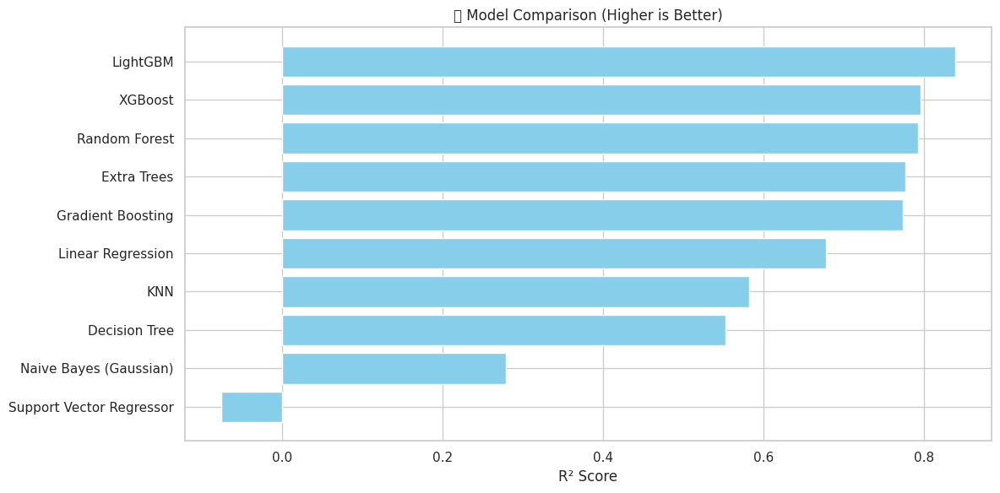

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.naive_bayes import GaussianNB
import xgboost as xgb
import lightgbm as lgb
import matplotlib.pyplot as plt

# === 1. Load the scaled dataset ===
df = pd.read_csv("/content/melbourne_mean_imputed.csv")  # Change path if needed

# === 2. Features and Target ===
X = df.drop("Price", axis=1)
y = df["Price"]

# === 3. Train/Test split ===
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 4. Initialize 10 regression models ===
models = {
    "Linear Regression": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(),
    "Random Forest": RandomForestRegressor(),
    "KNN": KNeighborsRegressor(),
    "Support Vector Regressor": SVR(),
    "Naive Bayes (Gaussian)": GaussianNB(),
    "Gradient Boosting": GradientBoostingRegressor(),
    "XGBoost": xgb.XGBRegressor(verbosity=0),
    "LightGBM": lgb.LGBMRegressor(),
    "Extra Trees": ExtraTreesRegressor()
}

# === 5. Train, Predict, Evaluate ===
results = []

print("🔧 Training Models...\n")
for name, model in models.items():
    try:
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Metrics
        r2 = r2_score(y_test, y_pred)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        mae = mean_absolute_error(y_test, y_pred)

        results.append({
            "Model": name,
            "R² Score": round(r2, 4),
            "RMSE": round(rmse, 4),
            "MAE": round(mae, 4)
        })
        print(f"✅ Trained: {name}")
    except Exception as e:
        print(f"❌ Failed: {name} | Error: {e}")

# === 6. Create Summary DataFrame ===
results_df = pd.DataFrame(results).sort_values(by="R² Score", ascending=False)

print("\n📊 Model Performance Summary:\n")
print(results_df)

# === 7. Plot R² Score Comparison ===
plt.figure(figsize=(12, 6))
plt.barh(results_df["Model"], results_df["R² Score"], color="skyblue")
plt.xlabel("R² Score")
plt.title("📈 Model Comparison (Higher is Better)")
plt.gca().invert_yaxis()
plt.grid(True)
plt.tight_layout()
plt.show()


# 6.2 Apply models on imputed median data set

🔧 Training Models...

✅ Trained: Linear Regression
✅ Trained: Decision Tree
✅ Trained: Random Forest
✅ Trained: KNN
✅ Trained: Support Vector Regressor
✅ Trained: Naive Bayes (Gaussian)
✅ Trained: Gradient Boosting
✅ Trained: XGBoost
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000709 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2227
[LightGBM] [Info] Number of data points in the train set: 10864, number of used features: 248
[LightGBM] [Info] Start training from score 1074964.928203
✅ Trained: LightGBM
✅ Trained: Extra Trees

📊 Model Performance Summary:

                      Model  R² Score         RMSE          MAE
8                  LightGBM    0.8388  253059.5558  161421.2453
7                   XGBoost    0.8033  279536.0968  164174.8262
2      

/tmp/ipython-input-32-2273420564.py:76: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



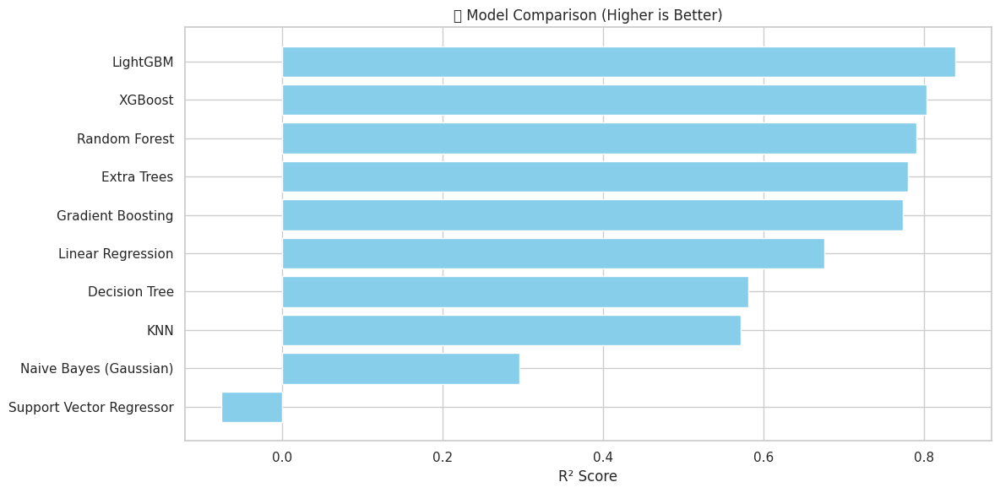

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.naive_bayes import GaussianNB
import xgboost as xgb
import lightgbm as lgb
import matplotlib.pyplot as plt

# === 1. Load the scaled dataset ===
df = pd.read_csv("/content/melbourne_median_imputed.csv")  # Change path if needed

# === 2. Features and Target ===
X = df.drop("Price", axis=1)
y = df["Price"]

# === 3. Train/Test split ===
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 4. Initialize 10 regression models ===
models = {
    "Linear Regression": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(),
    "Random Forest": RandomForestRegressor(),
    "KNN": KNeighborsRegressor(),
    "Support Vector Regressor": SVR(),
    "Naive Bayes (Gaussian)": GaussianNB(),
    "Gradient Boosting": GradientBoostingRegressor(),
    "XGBoost": xgb.XGBRegressor(verbosity=0),
    "LightGBM": lgb.LGBMRegressor(),
    "Extra Trees": ExtraTreesRegressor()
}

# === 5. Train, Predict, Evaluate ===
results = []

print("🔧 Training Models...\n")
for name, model in models.items():
    try:
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Metrics
        r2 = r2_score(y_test, y_pred)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        mae = mean_absolute_error(y_test, y_pred)

        results.append({
            "Model": name,
            "R² Score": round(r2, 4),
            "RMSE": round(rmse, 4),
            "MAE": round(mae, 4)
        })
        print(f"✅ Trained: {name}")
    except Exception as e:
        print(f"❌ Failed: {name} | Error: {e}")

# === 6. Create Summary DataFrame ===
results_df = pd.DataFrame(results).sort_values(by="R² Score", ascending=False)

print("\n📊 Model Performance Summary:\n")
print(results_df)

# === 7. Plot R² Score Comparison ===
plt.figure(figsize=(12, 6))
plt.barh(results_df["Model"], results_df["R² Score"], color="skyblue")
plt.xlabel("R² Score")
plt.title("📈 Model Comparison (Higher is Better)")
plt.gca().invert_yaxis()
plt.grid(True)
plt.tight_layout()
plt.show()

# 6.3 Apply models on imputed knn data set

🔧 Training Models...

✅ Trained: Linear Regression
✅ Trained: Decision Tree
✅ Trained: Random Forest
✅ Trained: KNN
✅ Trained: Support Vector Regressor
✅ Trained: Naive Bayes (Gaussian)
✅ Trained: Gradient Boosting
✅ Trained: XGBoost
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000682 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2459
[LightGBM] [Info] Number of data points in the train set: 10864, number of used features: 248
[LightGBM] [Info] Start training from score 1074964.928203
✅ Trained: LightGBM
✅ Trained: Extra Trees

📊 Model Performance Summary:

                      Model  R² Score         RMSE          MAE
8                  LightGBM    0.8638  232565.0687  149282.5622
7                   XGBoost    0.8436  249257.1444  156796.1644
2             Random Forest    0.8342  256650.8277  160108.4520
9      

/tmp/ipython-input-33-405270794.py:76: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



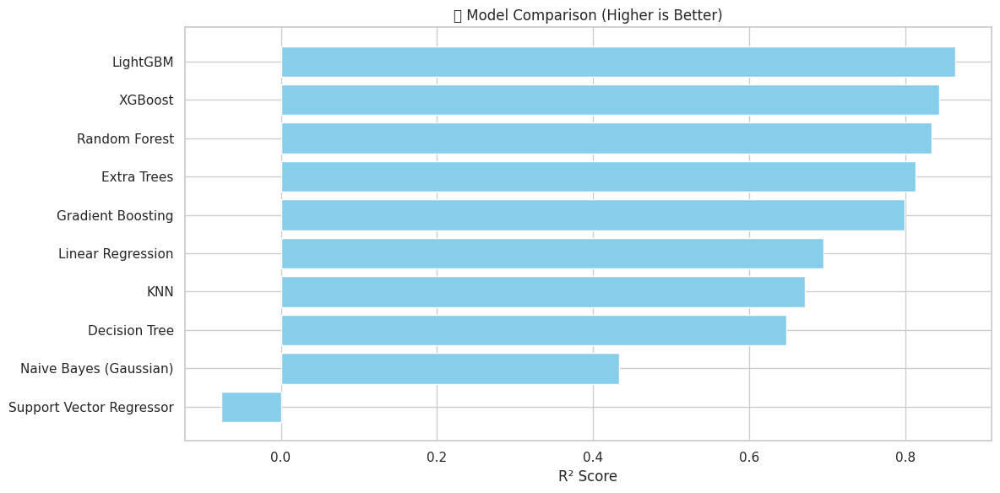

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.naive_bayes import GaussianNB
import xgboost as xgb
import lightgbm as lgb
import matplotlib.pyplot as plt

# === 1. Load the scaled dataset ===
df = pd.read_csv("/content/melbourne_knn_imputed.csv")  # Change path if needed

# === 2. Features and Target ===
X = df.drop("Price", axis=1)
y = df["Price"]

# === 3. Train/Test split ===
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 4. Initialize 10 regression models ===
models = {
    "Linear Regression": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(),
    "Random Forest": RandomForestRegressor(),
    "KNN": KNeighborsRegressor(),
    "Support Vector Regressor": SVR(),
    "Naive Bayes (Gaussian)": GaussianNB(),
    "Gradient Boosting": GradientBoostingRegressor(),
    "XGBoost": xgb.XGBRegressor(verbosity=0),
    "LightGBM": lgb.LGBMRegressor(),
    "Extra Trees": ExtraTreesRegressor()
}

# === 5. Train, Predict, Evaluate ===
results = []

print("🔧 Training Models...\n")
for name, model in models.items():
    try:
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Metrics
        r2 = r2_score(y_test, y_pred)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        mae = mean_absolute_error(y_test, y_pred)

        results.append({
            "Model": name,
            "R² Score": round(r2, 4),
            "RMSE": round(rmse, 4),
            "MAE": round(mae, 4)
        })
        print(f"✅ Trained: {name}")
    except Exception as e:
        print(f"❌ Failed: {name} | Error: {e}")

# === 6. Create Summary DataFrame ===
results_df = pd.DataFrame(results).sort_values(by="R² Score", ascending=False)

print("\n📊 Model Performance Summary:\n")
print(results_df)

# === 7. Plot R² Score Comparison ===
plt.figure(figsize=(12, 6))
plt.barh(results_df["Model"], results_df["R² Score"], color="skyblue")
plt.xlabel("R² Score")
plt.title("📈 Model Comparison (Higher is Better)")
plt.gca().invert_yaxis()
plt.grid(True)
plt.tight_layout()
plt.show()

# 6.4 Apply models on outlier treated mean   data set

🔧 Training Models...

✅ Trained: Linear Regression
✅ Trained: Decision Tree
✅ Trained: Random Forest
✅ Trained: KNN
✅ Trained: Support Vector Regressor
✅ Trained: Naive Bayes (Gaussian)
✅ Trained: Gradient Boosting
✅ Trained: XGBoost
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000717 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2232
[LightGBM] [Info] Number of data points in the train set: 10864, number of used features: 248
[LightGBM] [Info] Start training from score 1074964.928203
✅ Trained: LightGBM
✅ Trained: Extra Trees

📊 Model Performance Summary:

                      Model  R² Score         RMSE          MAE
8                  LightGBM    0.8384  253383.0982  161834.5873
2             Random Forest    0.7958  284769.4644  165074.3528
7                   XGBoost    0.7957  284864.2433  165839.6928
9      

/tmp/ipython-input-34-3851462799.py:76: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



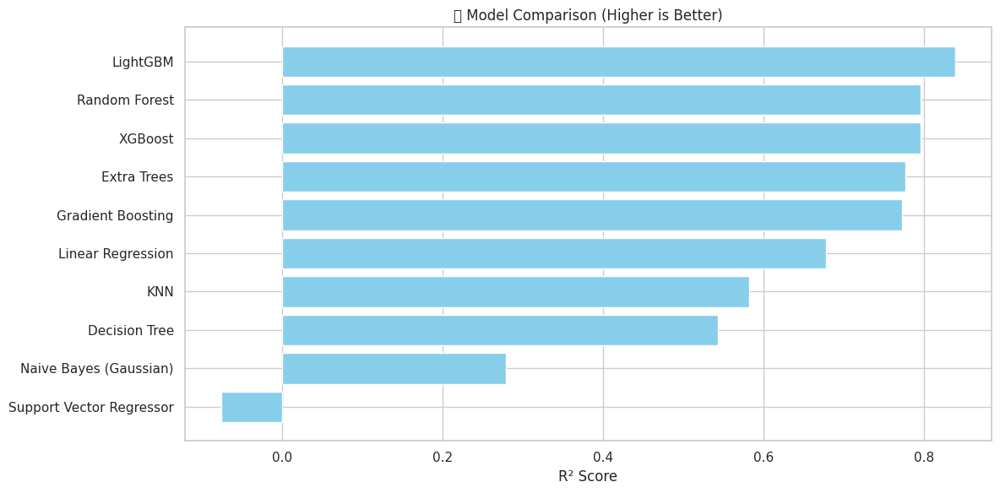

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.naive_bayes import GaussianNB
import xgboost as xgb
import lightgbm as lgb
import matplotlib.pyplot as plt

# === 1. Load the scaled dataset ===
df = pd.read_csv("/content/df_mean_treated.csv")  # Change path if needed

# === 2. Features and Target ===
X = df.drop("Price", axis=1)
y = df["Price"]

# === 3. Train/Test split ===
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 4. Initialize 10 regression models ===
models = {
    "Linear Regression": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(),
    "Random Forest": RandomForestRegressor(),
    "KNN": KNeighborsRegressor(),
    "Support Vector Regressor": SVR(),
    "Naive Bayes (Gaussian)": GaussianNB(),
    "Gradient Boosting": GradientBoostingRegressor(),
    "XGBoost": xgb.XGBRegressor(verbosity=0),
    "LightGBM": lgb.LGBMRegressor(),
    "Extra Trees": ExtraTreesRegressor()
}

# === 5. Train, Predict, Evaluate ===
results = []

print("🔧 Training Models...\n")
for name, model in models.items():
    try:
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Metrics
        r2 = r2_score(y_test, y_pred)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        mae = mean_absolute_error(y_test, y_pred)

        results.append({
            "Model": name,
            "R² Score": round(r2, 4),
            "RMSE": round(rmse, 4),
            "MAE": round(mae, 4)
        })
        print(f"✅ Trained: {name}")
    except Exception as e:
        print(f"❌ Failed: {name} | Error: {e}")

# === 6. Create Summary DataFrame ===
results_df = pd.DataFrame(results).sort_values(by="R² Score", ascending=False)

print("\n📊 Model Performance Summary:\n")
print(results_df)

# === 7. Plot R² Score Comparison ===
plt.figure(figsize=(12, 6))
plt.barh(results_df["Model"], results_df["R² Score"], color="skyblue")
plt.xlabel("R² Score")
plt.title("📈 Model Comparison (Higher is Better)")
plt.gca().invert_yaxis()
plt.grid(True)
plt.tight_layout()
plt.show()

# 6.5 Apply models on outlier treated median  data set

🔧 Training Models...

✅ Trained: Linear Regression
✅ Trained: Decision Tree
✅ Trained: Random Forest
✅ Trained: KNN
✅ Trained: Support Vector Regressor
✅ Trained: Naive Bayes (Gaussian)
✅ Trained: Gradient Boosting
✅ Trained: XGBoost
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000762 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2227
[LightGBM] [Info] Number of data points in the train set: 10864, number of used features: 248
[LightGBM] [Info] Start training from score 1074964.928203
✅ Trained: LightGBM
✅ Trained: Extra Trees

📊 Model Performance Summary:

                      Model  R² Score         RMSE          MAE
8                  LightGBM    0.8388  253059.5558  161421.2453
7                   XGBoost    0.8033  279536.0968  164174.8262
2             Random Forest    0.7834  293341.6888  166085.9940
9      

/tmp/ipython-input-35-3485545094.py:76: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



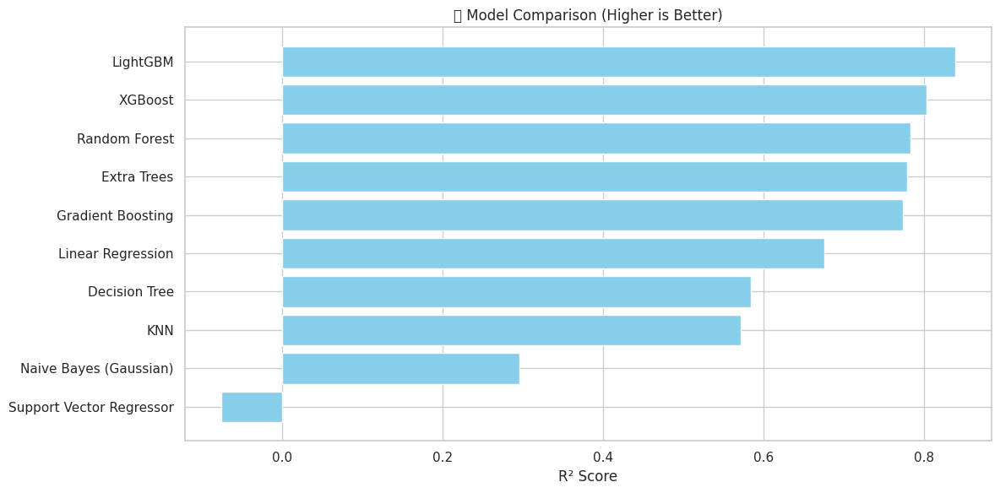

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.naive_bayes import GaussianNB
import xgboost as xgb
import lightgbm as lgb
import matplotlib.pyplot as plt

# === 1. Load the scaled dataset ===
df = pd.read_csv("/content/df_median_treated.csv")  # Change path if needed

# === 2. Features and Target ===
X = df.drop("Price", axis=1)
y = df["Price"]

# === 3. Train/Test split ===
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 4. Initialize 10 regression models ===
models = {
    "Linear Regression": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(),
    "Random Forest": RandomForestRegressor(),
    "KNN": KNeighborsRegressor(),
    "Support Vector Regressor": SVR(),
    "Naive Bayes (Gaussian)": GaussianNB(),
    "Gradient Boosting": GradientBoostingRegressor(),
    "XGBoost": xgb.XGBRegressor(verbosity=0),
    "LightGBM": lgb.LGBMRegressor(),
    "Extra Trees": ExtraTreesRegressor()
}

# === 5. Train, Predict, Evaluate ===
results = []

print("🔧 Training Models...\n")
for name, model in models.items():
    try:
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Metrics
        r2 = r2_score(y_test, y_pred)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        mae = mean_absolute_error(y_test, y_pred)

        results.append({
            "Model": name,
            "R² Score": round(r2, 4),
            "RMSE": round(rmse, 4),
            "MAE": round(mae, 4)
        })
        print(f"✅ Trained: {name}")
    except Exception as e:
        print(f"❌ Failed: {name} | Error: {e}")

# === 6. Create Summary DataFrame ===
results_df = pd.DataFrame(results).sort_values(by="R² Score", ascending=False)

print("\n📊 Model Performance Summary:\n")
print(results_df)

# === 7. Plot R² Score Comparison ===
plt.figure(figsize=(12, 6))
plt.barh(results_df["Model"], results_df["R² Score"], color="skyblue")
plt.xlabel("R² Score")
plt.title("📈 Model Comparison (Higher is Better)")
plt.gca().invert_yaxis()
plt.grid(True)
plt.tight_layout()
plt.show()

# 6.6 Apply models on outlier treated knn   data set

🔧 Training Models...

✅ Trained: Linear Regression
✅ Trained: Decision Tree
✅ Trained: Random Forest
✅ Trained: KNN
✅ Trained: Support Vector Regressor
✅ Trained: Naive Bayes (Gaussian)
✅ Trained: Gradient Boosting
✅ Trained: XGBoost
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000588 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2459
[LightGBM] [Info] Number of data points in the train set: 10864, number of used features: 248
[LightGBM] [Info] Start training from score 1074964.928203
✅ Trained: LightGBM
✅ Trained: Extra Trees

📊 Model Performance Summary:

                      Model  R² Score         RMSE          MAE
8                  LightGBM    0.8638  232565.0687  149282.5622
7                   XGBoost    0.8436  249257.1444  156796.1644
2      

/tmp/ipython-input-36-1700139003.py:76: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



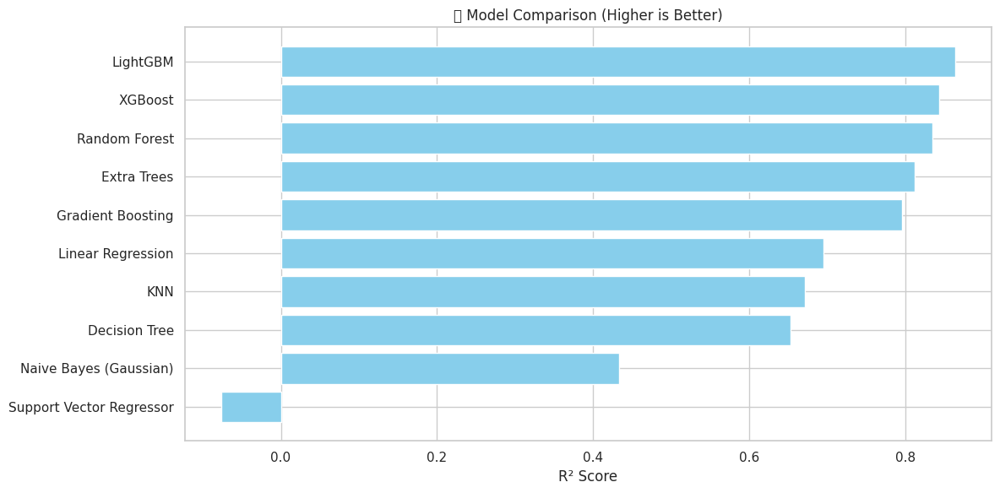

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.naive_bayes import GaussianNB
import xgboost as xgb
import lightgbm as lgb
import matplotlib.pyplot as plt

# === 1. Load the scaled dataset ===
df = pd.read_csv("/content/df_knn_treated.csv")  # Change path if needed

# === 2. Features and Target ===
X = df.drop("Price", axis=1)
y = df["Price"]

# === 3. Train/Test split ===
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 4. Initialize 10 regression models ===
models = {
    "Linear Regression": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(),
    "Random Forest": RandomForestRegressor(),
    "KNN": KNeighborsRegressor(),
    "Support Vector Regressor": SVR(),
    "Naive Bayes (Gaussian)": GaussianNB(),
    "Gradient Boosting": GradientBoostingRegressor(),
    "XGBoost": xgb.XGBRegressor(verbosity=0),
    "LightGBM": lgb.LGBMRegressor(),
    "Extra Trees": ExtraTreesRegressor()
}

# === 5. Train, Predict, Evaluate ===
results = []

print("🔧 Training Models...\n")
for name, model in models.items():
    try:
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Metrics
        r2 = r2_score(y_test, y_pred)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        mae = mean_absolute_error(y_test, y_pred)

        results.append({
            "Model": name,
            "R² Score": round(r2, 4),
            "RMSE": round(rmse, 4),
            "MAE": round(mae, 4)
        })
        print(f"✅ Trained: {name}")
    except Exception as e:
        print(f"❌ Failed: {name} | Error: {e}")

# === 6. Create Summary DataFrame ===
results_df = pd.DataFrame(results).sort_values(by="R² Score", ascending=False)

print("\n📊 Model Performance Summary:\n")
print(results_df)

# === 7. Plot R² Score Comparison ===
plt.figure(figsize=(12, 6))
plt.barh(results_df["Model"], results_df["R² Score"], color="skyblue")
plt.xlabel("R² Score")
plt.title("📈 Model Comparison (Higher is Better)")
plt.gca().invert_yaxis()
plt.grid(True)
plt.tight_layout()
plt.show()

#7
#classification matric

#AUC-ROC curve

#confussion matrix

# 7.1 classsification matrix on mean imputed data set

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression




📌 Logistic Regression - Confusion Matrix:
[[1165  201]
 [ 222 1128]]

📄 Logistic Regression - Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.85      0.85      1366
           1       0.85      0.84      0.84      1350

    accuracy                           0.84      2716
   macro avg       0.84      0.84      0.84      2716
weighted avg       0.84      0.84      0.84      2716


📌 Random Forest - Confusion Matrix:
[[1228  138]
 [ 155 1195]]

📄 Random Forest - Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.90      0.89      1366
           1       0.90      0.89      0.89      1350

    accuracy                           0.89      2716
   macro avg       0.89      0.89      0.89      2716
weighted avg       0.89      0.89      0.89      2716


📌 Gradient Boosting - Confusion Matrix:
[[1218  148]
 [ 134 1216]]

📄 Gradient Boosting - Classification Report:
        

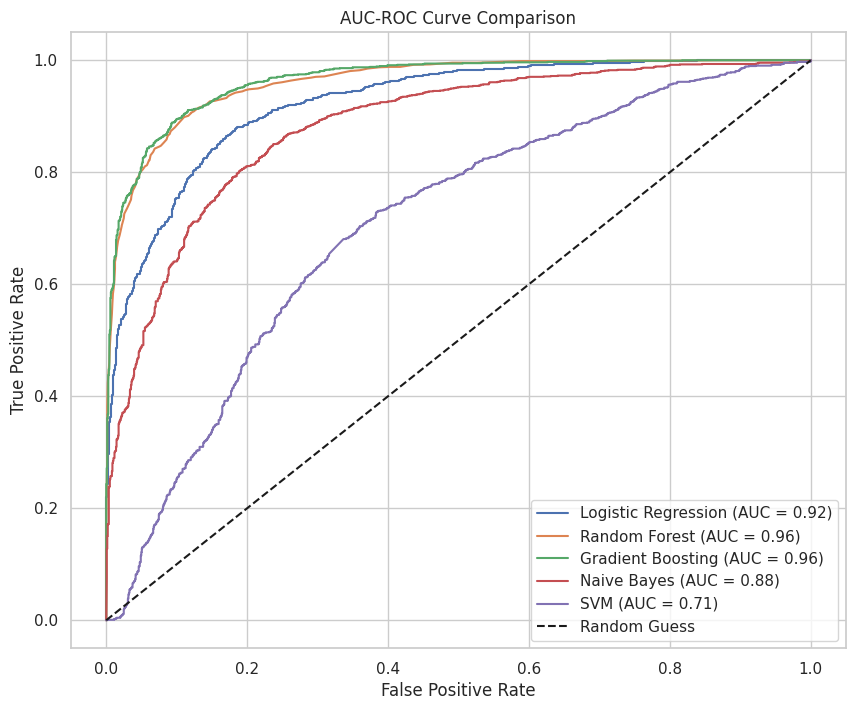


📊 Model Evaluation Summary:
                 Model  Accuracy  Precision  Recall  F1 Score     AUC
2    Gradient Boosting    0.8962     0.8915  0.9007    0.8961  0.9641
1        Random Forest    0.8921     0.8965  0.8852    0.8908  0.9609
0  Logistic Regression    0.8443     0.8488  0.8356    0.8421  0.9240
3          Naive Bayes    0.8023     0.7641  0.8711    0.8141  0.8822
4                  SVM    0.6690     0.6587  0.6933    0.6756  0.7055


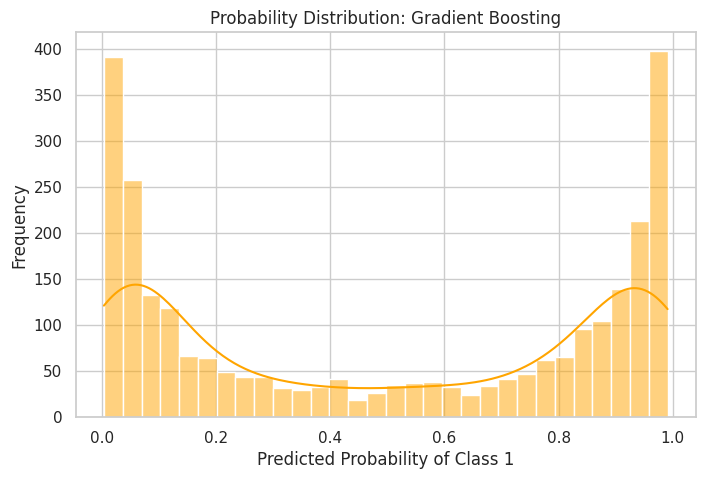

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    confusion_matrix, classification_report, roc_curve, roc_auc_score,
    accuracy_score, precision_score, recall_score, f1_score
)
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

# === 1. Load and prepare dataset ===
df = pd.read_csv("/content/melbourne_mean_imputed.csv")

# Convert regression to binary classification: high price (1) vs low price (0)
median_price = df["Price"].median()
df["Price_Class"] = df["Price"].apply(lambda x: 1 if x > median_price else 0)

X = df.drop(columns=["Price", "Price_Class"])
y = df["Price_Class"]

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 2. Define classification models ===
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "Naive Bayes": GaussianNB(),
    "SVM": SVC(probability=True)
}

# === 3. Initialize evaluation container ===
results = []

plt.figure(figsize=(10, 8))
plt.title("AUC-ROC Curve Comparison")

# === 4. Train, evaluate, and plot ===
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]

    # Metrics
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    results.append({
        "Model": name,
        "Accuracy": round(acc, 4),
        "Precision": round(prec, 4),
        "Recall": round(rec, 4),
        "F1 Score": round(f1, 4),
        "AUC": round(auc, 4)
    })

    # === Plot AUC ROC curve ===
    fpr, tpr, thresholds = roc_curve(y_test, y_prob)
    plt.plot(fpr, tpr, label=f"{name} (AUC = {auc:.2f})")

    # === Confusion Matrix ===
    cm = confusion_matrix(y_test, y_pred)
    print(f"\n📌 {name} - Confusion Matrix:")
    print(cm)

    # === Classification Report ===
    print(f"\n📄 {name} - Classification Report:")
    print(classification_report(y_test, y_pred))

# === 5. Show ROC Curve ===
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# === 6. Summary Table ===
results_df = pd.DataFrame(results).sort_values(by="AUC", ascending=False)
print("\n📊 Model Evaluation Summary:")
print(results_df)

# === 7. Optional: Probability Histogram for one model ===
best_model_name = results_df.iloc[0]["Model"]
best_model = models[best_model_name]
y_prob = best_model.predict_proba(X_test)[:, 1]

plt.figure(figsize=(8, 5))
sns.histplot(y_prob, bins=30, kde=True, color='orange')
plt.title(f"Probability Distribution: {best_model_name}")
plt.xlabel("Predicted Probability of Class 1")
plt.ylabel("Frequency")
plt.show()


# 7.2 classsification matrix on median imputed data set

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression




📌 Logistic Regression - Confusion Matrix:
[[1157  209]
 [ 225 1125]]

📄 Logistic Regression - Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1366
           1       0.84      0.83      0.84      1350

    accuracy                           0.84      2716
   macro avg       0.84      0.84      0.84      2716
weighted avg       0.84      0.84      0.84      2716


📌 Random Forest - Confusion Matrix:
[[1228  138]
 [ 151 1199]]

📄 Random Forest - Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.90      0.89      1366
           1       0.90      0.89      0.89      1350

    accuracy                           0.89      2716
   macro avg       0.89      0.89      0.89      2716
weighted avg       0.89      0.89      0.89      2716


📌 Gradient Boosting - Confusion Matrix:
[[1219  147]
 [ 136 1214]]

📄 Gradient Boosting - Classification Report:
        

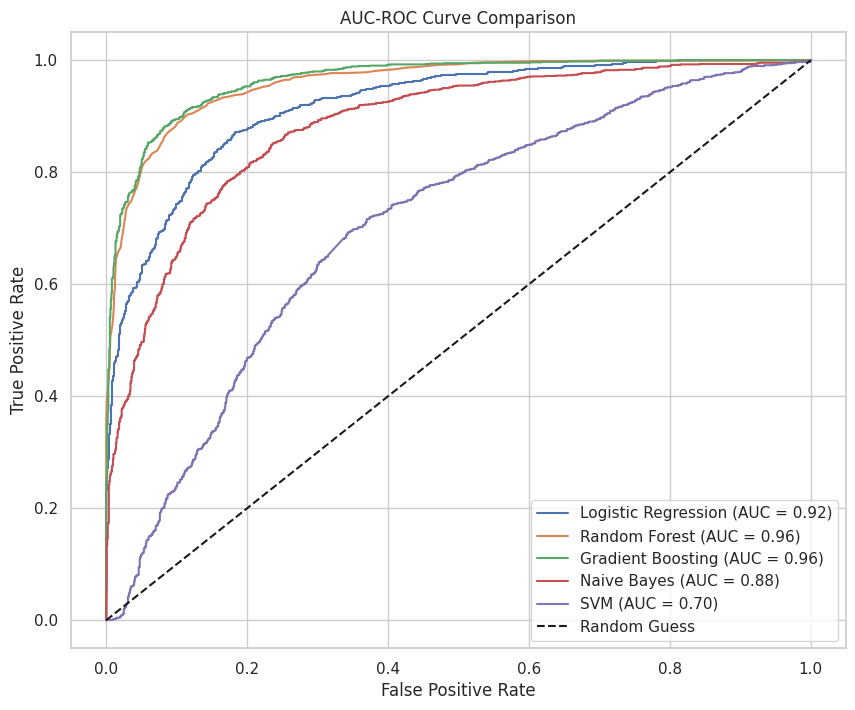


📊 Model Evaluation Summary:
                 Model  Accuracy  Precision  Recall  F1 Score     AUC
2    Gradient Boosting    0.8958     0.8920  0.8993    0.8956  0.9649
1        Random Forest    0.8936     0.8968  0.8881    0.8924  0.9600
0  Logistic Regression    0.8402     0.8433  0.8333    0.8383  0.9191
3          Naive Bayes    0.8060     0.7691  0.8711    0.8170  0.8835
4                  SVM    0.6738     0.6648  0.6933    0.6788  0.7042


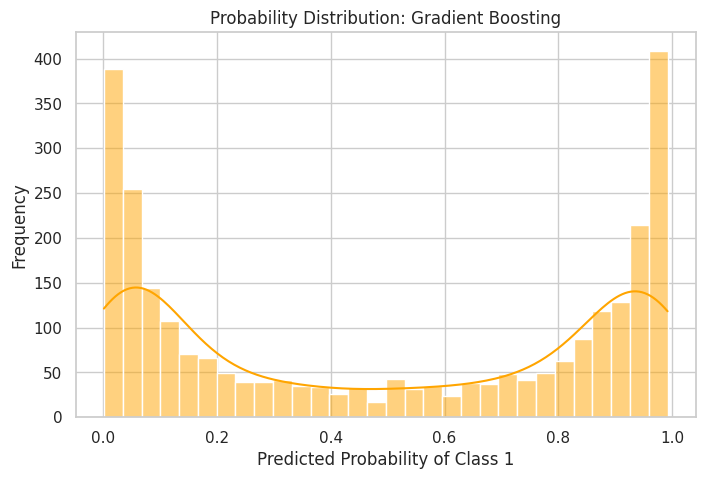

In [38]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    confusion_matrix, classification_report, roc_curve, roc_auc_score,
    accuracy_score, precision_score, recall_score, f1_score
)
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

# === 1. Load and prepare dataset ===
df = pd.read_csv("/content/melbourne_median_imputed.csv")

# Convert regression to binary classification: high price (1) vs low price (0)
median_price = df["Price"].median()
df["Price_Class"] = df["Price"].apply(lambda x: 1 if x > median_price else 0)

X = df.drop(columns=["Price", "Price_Class"])
y = df["Price_Class"]

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 2. Define classification models ===
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "Naive Bayes": GaussianNB(),
    "SVM": SVC(probability=True)
}

# === 3. Initialize evaluation container ===
results = []

plt.figure(figsize=(10, 8))
plt.title("AUC-ROC Curve Comparison")

# === 4. Train, evaluate, and plot ===
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]

    # Metrics
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    results.append({
        "Model": name,
        "Accuracy": round(acc, 4),
        "Precision": round(prec, 4),
        "Recall": round(rec, 4),
        "F1 Score": round(f1, 4),
        "AUC": round(auc, 4)
    })

    # === Plot AUC ROC curve ===
    fpr, tpr, thresholds = roc_curve(y_test, y_prob)
    plt.plot(fpr, tpr, label=f"{name} (AUC = {auc:.2f})")

    # === Confusion Matrix ===
    cm = confusion_matrix(y_test, y_pred)
    print(f"\n📌 {name} - Confusion Matrix:")
    print(cm)

    # === Classification Report ===
    print(f"\n📄 {name} - Classification Report:")
    print(classification_report(y_test, y_pred))

# === 5. Show ROC Curve ===
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# === 6. Summary Table ===
results_df = pd.DataFrame(results).sort_values(by="AUC", ascending=False)
print("\n📊 Model Evaluation Summary:")
print(results_df)

# === 7. Optional: Probability Histogram for one model ===
best_model_name = results_df.iloc[0]["Model"]
best_model = models[best_model_name]
y_prob = best_model.predict_proba(X_test)[:, 1]

plt.figure(figsize=(8, 5))
sns.histplot(y_prob, bins=30, kde=True, color='orange')
plt.title(f"Probability Distribution: {best_model_name}")
plt.xlabel("Predicted Probability of Class 1")
plt.ylabel("Frequency")
plt.show()


# 7.3 classsification matrix on knn imputed data set

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression




📌 Logistic Regression - Confusion Matrix:
[[1171  195]
 [ 200 1150]]

📄 Logistic Regression - Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.86      0.86      1366
           1       0.86      0.85      0.85      1350

    accuracy                           0.85      2716
   macro avg       0.85      0.85      0.85      2716
weighted avg       0.85      0.85      0.85      2716


📌 Random Forest - Confusion Matrix:
[[1251  115]
 [ 137 1213]]

📄 Random Forest - Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.92      0.91      1366
           1       0.91      0.90      0.91      1350

    accuracy                           0.91      2716
   macro avg       0.91      0.91      0.91      2716
weighted avg       0.91      0.91      0.91      2716


📌 Gradient Boosting - Confusion Matrix:
[[1248  118]
 [ 146 1204]]

📄 Gradient Boosting - Classification Report:
        

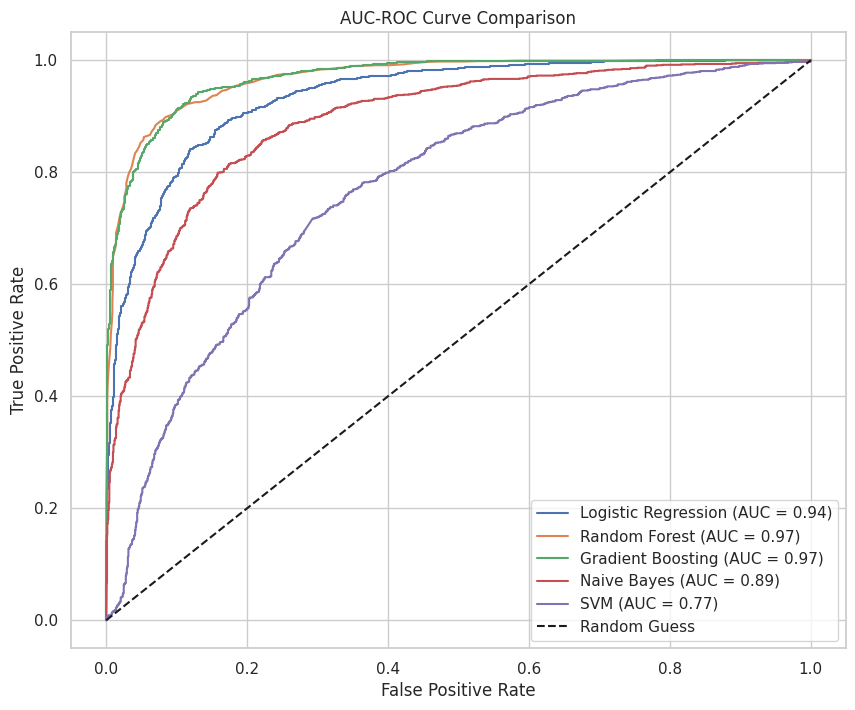


📊 Model Evaluation Summary:
                 Model  Accuracy  Precision  Recall  F1 Score     AUC
2    Gradient Boosting    0.9028     0.9107  0.8919    0.9012  0.9692
1        Random Forest    0.9072     0.9134  0.8985    0.9059  0.9688
0  Logistic Regression    0.8546     0.8550  0.8519    0.8534  0.9356
3          Naive Bayes    0.8119     0.7715  0.8830    0.8235  0.8925
4                  SVM    0.7073     0.7091  0.6970    0.7030  0.7680


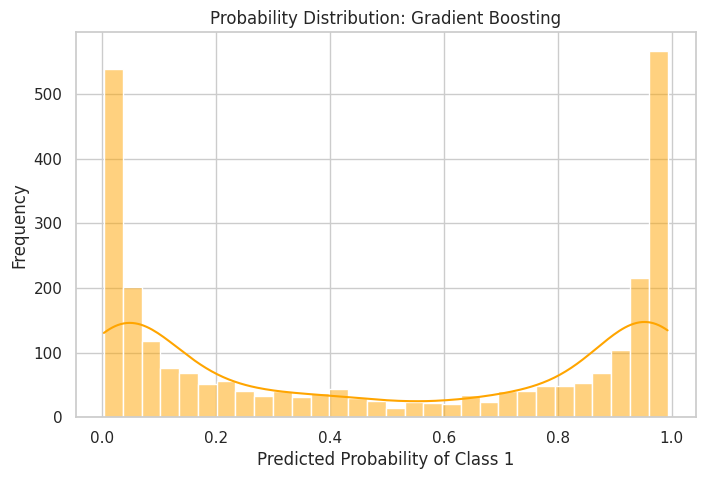

In [39]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    confusion_matrix, classification_report, roc_curve, roc_auc_score,
    accuracy_score, precision_score, recall_score, f1_score
)
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

# === 1. Load and prepare dataset ===
df = pd.read_csv("/content/melbourne_knn_imputed.csv")

# Convert regression to binary classification: high price (1) vs low price (0)
median_price = df["Price"].median()
df["Price_Class"] = df["Price"].apply(lambda x: 1 if x > median_price else 0)

X = df.drop(columns=["Price", "Price_Class"])
y = df["Price_Class"]

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 2. Define classification models ===
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "Naive Bayes": GaussianNB(),
    "SVM": SVC(probability=True)
}

# === 3. Initialize evaluation container ===
results = []

plt.figure(figsize=(10, 8))
plt.title("AUC-ROC Curve Comparison")

# === 4. Train, evaluate, and plot ===
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]

    # Metrics
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    results.append({
        "Model": name,
        "Accuracy": round(acc, 4),
        "Precision": round(prec, 4),
        "Recall": round(rec, 4),
        "F1 Score": round(f1, 4),
        "AUC": round(auc, 4)
    })

    # === Plot AUC ROC curve ===
    fpr, tpr, thresholds = roc_curve(y_test, y_prob)
    plt.plot(fpr, tpr, label=f"{name} (AUC = {auc:.2f})")

    # === Confusion Matrix ===
    cm = confusion_matrix(y_test, y_pred)
    print(f"\n📌 {name} - Confusion Matrix:")
    print(cm)

    # === Classification Report ===
    print(f"\n📄 {name} - Classification Report:")
    print(classification_report(y_test, y_pred))

# === 5. Show ROC Curve ===
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# === 6. Summary Table ===
results_df = pd.DataFrame(results).sort_values(by="AUC", ascending=False)
print("\n📊 Model Evaluation Summary:")
print(results_df)

# === 7. Optional: Probability Histogram for one model ===
best_model_name = results_df.iloc[0]["Model"]
best_model = models[best_model_name]
y_prob = best_model.predict_proba(X_test)[:, 1]

plt.figure(figsize=(8, 5))
sns.histplot(y_prob, bins=30, kde=True, color='orange')
plt.title(f"Probability Distribution: {best_model_name}")
plt.xlabel("Predicted Probability of Class 1")
plt.ylabel("Frequency")
plt.show()


# 7.4 classsification matrix on mean terated data set

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression




📌 Logistic Regression - Confusion Matrix:
[[1165  201]
 [ 222 1128]]

📄 Logistic Regression - Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.85      0.85      1366
           1       0.85      0.84      0.84      1350

    accuracy                           0.84      2716
   macro avg       0.84      0.84      0.84      2716
weighted avg       0.84      0.84      0.84      2716


📌 Random Forest - Confusion Matrix:
[[1231  135]
 [ 154 1196]]

📄 Random Forest - Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.90      0.89      1366
           1       0.90      0.89      0.89      1350

    accuracy                           0.89      2716
   macro avg       0.89      0.89      0.89      2716
weighted avg       0.89      0.89      0.89      2716


📌 Gradient Boosting - Confusion Matrix:
[[1219  147]
 [ 134 1216]]

📄 Gradient Boosting - Classification Report:
        

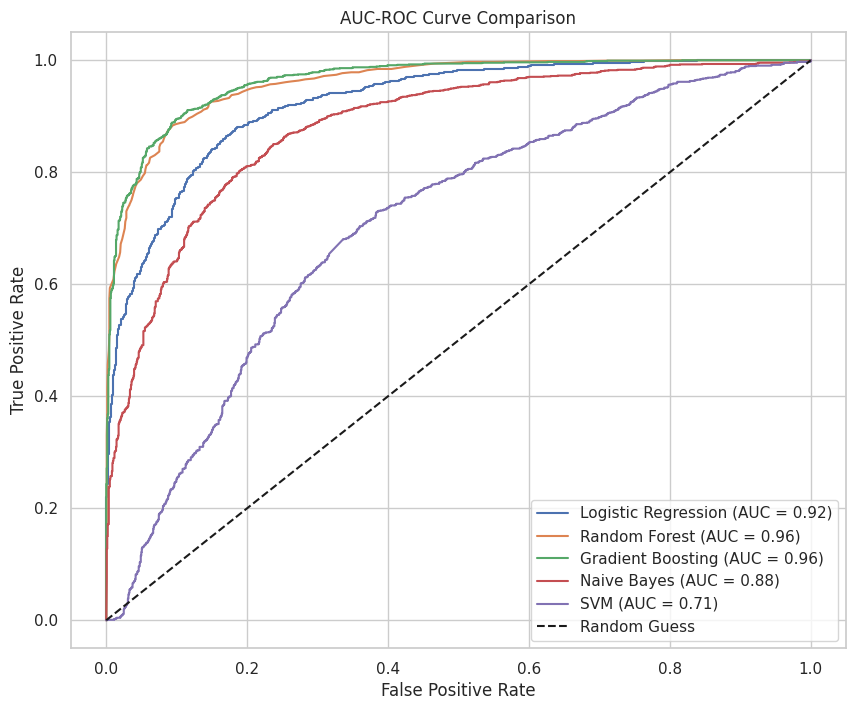


📊 Model Evaluation Summary:
                 Model  Accuracy  Precision  Recall  F1 Score     AUC
2    Gradient Boosting    0.8965     0.8921  0.9007    0.8964  0.9642
1        Random Forest    0.8936     0.8986  0.8859    0.8922  0.9602
0  Logistic Regression    0.8443     0.8488  0.8356    0.8421  0.9240
3          Naive Bayes    0.8023     0.7641  0.8711    0.8141  0.8822
4                  SVM    0.6690     0.6587  0.6933    0.6756  0.7055


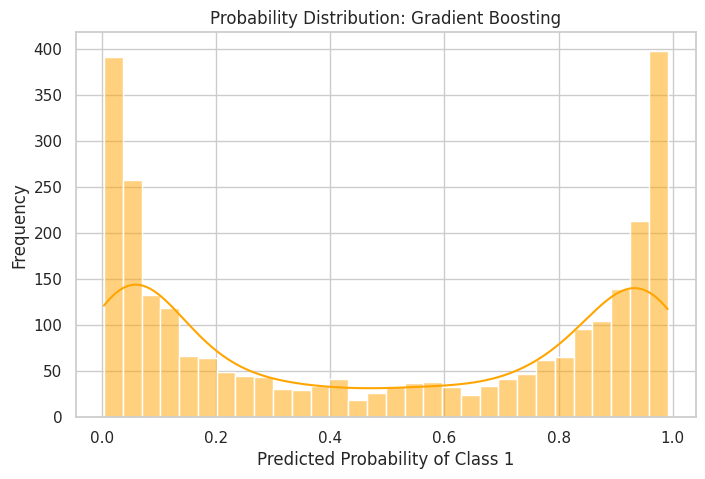

In [40]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    confusion_matrix, classification_report, roc_curve, roc_auc_score,
    accuracy_score, precision_score, recall_score, f1_score
)
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

# === 1. Load and prepare dataset ===
df = pd.read_csv("/content/df_mean_treated.csv")

# Convert regression to binary classification: high price (1) vs low price (0)
median_price = df["Price"].median()
df["Price_Class"] = df["Price"].apply(lambda x: 1 if x > median_price else 0)

X = df.drop(columns=["Price", "Price_Class"])
y = df["Price_Class"]

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 2. Define classification models ===
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "Naive Bayes": GaussianNB(),
    "SVM": SVC(probability=True)
}

# === 3. Initialize evaluation container ===
results = []

plt.figure(figsize=(10, 8))
plt.title("AUC-ROC Curve Comparison")

# === 4. Train, evaluate, and plot ===
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]

    # Metrics
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    results.append({
        "Model": name,
        "Accuracy": round(acc, 4),
        "Precision": round(prec, 4),
        "Recall": round(rec, 4),
        "F1 Score": round(f1, 4),
        "AUC": round(auc, 4)
    })

    # === Plot AUC ROC curve ===
    fpr, tpr, thresholds = roc_curve(y_test, y_prob)
    plt.plot(fpr, tpr, label=f"{name} (AUC = {auc:.2f})")

    # === Confusion Matrix ===
    cm = confusion_matrix(y_test, y_pred)
    print(f"\n📌 {name} - Confusion Matrix:")
    print(cm)

    # === Classification Report ===
    print(f"\n📄 {name} - Classification Report:")
    print(classification_report(y_test, y_pred))

# === 5. Show ROC Curve ===
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# === 6. Summary Table ===
results_df = pd.DataFrame(results).sort_values(by="AUC", ascending=False)
print("\n📊 Model Evaluation Summary:")
print(results_df)

# === 7. Optional: Probability Histogram for one model ===
best_model_name = results_df.iloc[0]["Model"]
best_model = models[best_model_name]
y_prob = best_model.predict_proba(X_test)[:, 1]

plt.figure(figsize=(8, 5))
sns.histplot(y_prob, bins=30, kde=True, color='orange')
plt.title(f"Probability Distribution: {best_model_name}")
plt.xlabel("Predicted Probability of Class 1")
plt.ylabel("Frequency")
plt.show()


# 7.5 classsification matrix on median treated data set

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression




📌 Logistic Regression - Confusion Matrix:
[[1157  209]
 [ 225 1125]]

📄 Logistic Regression - Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1366
           1       0.84      0.83      0.84      1350

    accuracy                           0.84      2716
   macro avg       0.84      0.84      0.84      2716
weighted avg       0.84      0.84      0.84      2716


📌 Random Forest - Confusion Matrix:
[[1226  140]
 [ 157 1193]]

📄 Random Forest - Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.90      0.89      1366
           1       0.89      0.88      0.89      1350

    accuracy                           0.89      2716
   macro avg       0.89      0.89      0.89      2716
weighted avg       0.89      0.89      0.89      2716


📌 Gradient Boosting - Confusion Matrix:
[[1218  148]
 [ 136 1214]]

📄 Gradient Boosting - Classification Report:
        

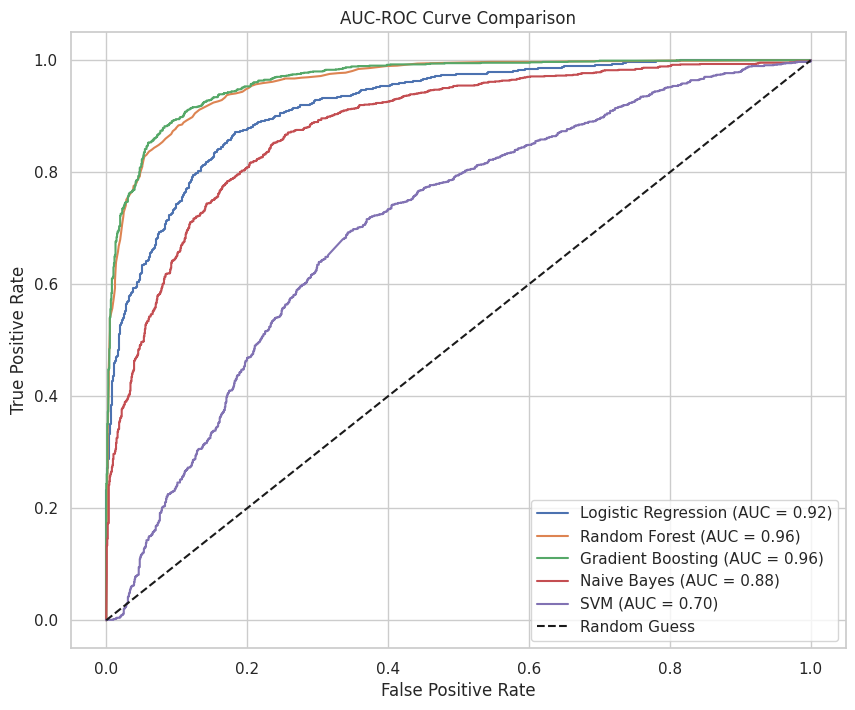


📊 Model Evaluation Summary:
                 Model  Accuracy  Precision  Recall  F1 Score     AUC
2    Gradient Boosting    0.8954     0.8913  0.8993    0.8953  0.9648
1        Random Forest    0.8906     0.8950  0.8837    0.8893  0.9611
0  Logistic Regression    0.8402     0.8433  0.8333    0.8383  0.9191
3          Naive Bayes    0.8060     0.7691  0.8711    0.8170  0.8835
4                  SVM    0.6738     0.6648  0.6933    0.6788  0.7042


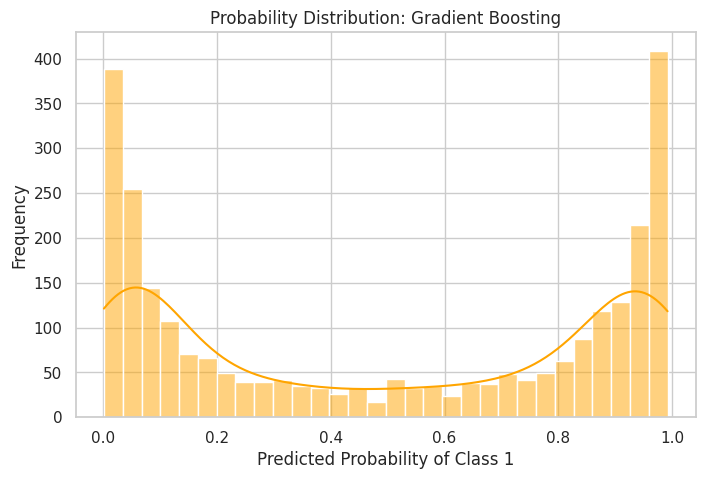

In [41]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    confusion_matrix, classification_report, roc_curve, roc_auc_score,
    accuracy_score, precision_score, recall_score, f1_score
)
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

# === 1. Load and prepare dataset ===
df = pd.read_csv("/content/df_median_treated.csv")

# Convert regression to binary classification: high price (1) vs low price (0)
median_price = df["Price"].median()
df["Price_Class"] = df["Price"].apply(lambda x: 1 if x > median_price else 0)

X = df.drop(columns=["Price", "Price_Class"])
y = df["Price_Class"]

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 2. Define classification models ===
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "Naive Bayes": GaussianNB(),
    "SVM": SVC(probability=True)
}

# === 3. Initialize evaluation container ===
results = []

plt.figure(figsize=(10, 8))
plt.title("AUC-ROC Curve Comparison")

# === 4. Train, evaluate, and plot ===
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]

    # Metrics
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    results.append({
        "Model": name,
        "Accuracy": round(acc, 4),
        "Precision": round(prec, 4),
        "Recall": round(rec, 4),
        "F1 Score": round(f1, 4),
        "AUC": round(auc, 4)
    })

    # === Plot AUC ROC curve ===
    fpr, tpr, thresholds = roc_curve(y_test, y_prob)
    plt.plot(fpr, tpr, label=f"{name} (AUC = {auc:.2f})")

    # === Confusion Matrix ===
    cm = confusion_matrix(y_test, y_pred)
    print(f"\n📌 {name} - Confusion Matrix:")
    print(cm)

    # === Classification Report ===
    print(f"\n📄 {name} - Classification Report:")
    print(classification_report(y_test, y_pred))

# === 5. Show ROC Curve ===
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# === 6. Summary Table ===
results_df = pd.DataFrame(results).sort_values(by="AUC", ascending=False)
print("\n📊 Model Evaluation Summary:")
print(results_df)

# === 7. Optional: Probability Histogram for one model ===
best_model_name = results_df.iloc[0]["Model"]
best_model = models[best_model_name]
y_prob = best_model.predict_proba(X_test)[:, 1]

plt.figure(figsize=(8, 5))
sns.histplot(y_prob, bins=30, kde=True, color='orange')
plt.title(f"Probability Distribution: {best_model_name}")
plt.xlabel("Predicted Probability of Class 1")
plt.ylabel("Frequency")
plt.show()


# 7.6 classsification matrix on knn treated data set

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression




📌 Logistic Regression - Confusion Matrix:
[[1171  195]
 [ 200 1150]]

📄 Logistic Regression - Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.86      0.86      1366
           1       0.86      0.85      0.85      1350

    accuracy                           0.85      2716
   macro avg       0.85      0.85      0.85      2716
weighted avg       0.85      0.85      0.85      2716


📌 Random Forest - Confusion Matrix:
[[1242  124]
 [ 140 1210]]

📄 Random Forest - Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.91      0.90      1366
           1       0.91      0.90      0.90      1350

    accuracy                           0.90      2716
   macro avg       0.90      0.90      0.90      2716
weighted avg       0.90      0.90      0.90      2716


📌 Gradient Boosting - Confusion Matrix:
[[1248  118]
 [ 146 1204]]

📄 Gradient Boosting - Classification Report:
        

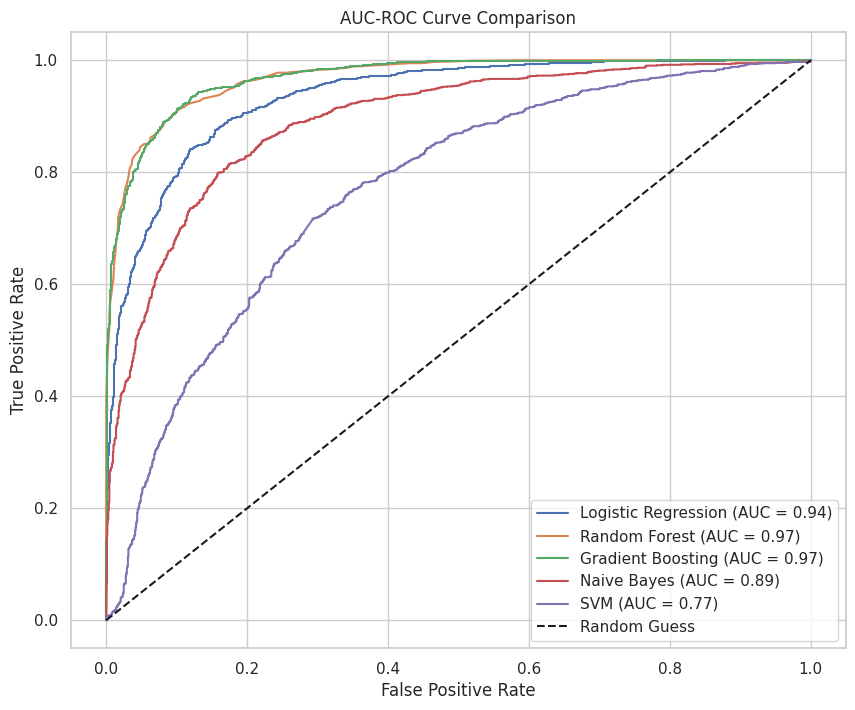


📊 Model Evaluation Summary:
                 Model  Accuracy  Precision  Recall  F1 Score     AUC
1        Random Forest    0.9028     0.9070  0.8963    0.9016  0.9694
2    Gradient Boosting    0.9028     0.9107  0.8919    0.9012  0.9693
0  Logistic Regression    0.8546     0.8550  0.8519    0.8534  0.9356
3          Naive Bayes    0.8119     0.7715  0.8830    0.8235  0.8925
4                  SVM    0.7073     0.7091  0.6970    0.7030  0.7680


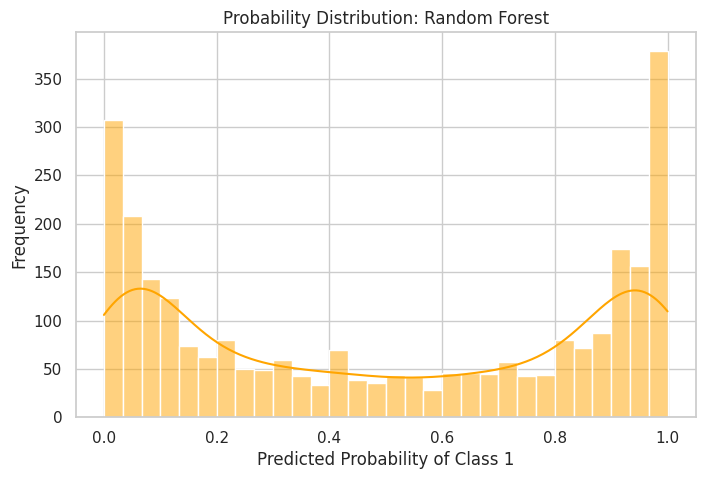

In [42]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    confusion_matrix, classification_report, roc_curve, roc_auc_score,
    accuracy_score, precision_score, recall_score, f1_score
)
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

# === 1. Load and prepare dataset ===
df = pd.read_csv("/content/df_knn_treated.csv")

# Convert regression to binary classification: high price (1) vs low price (0)
median_price = df["Price"].median()
df["Price_Class"] = df["Price"].apply(lambda x: 1 if x > median_price else 0)

X = df.drop(columns=["Price", "Price_Class"])
y = df["Price_Class"]

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# === 2. Define classification models ===
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "Naive Bayes": GaussianNB(),
    "SVM": SVC(probability=True)
}

# === 3. Initialize evaluation container ===
results = []

plt.figure(figsize=(10, 8))
plt.title("AUC-ROC Curve Comparison")

# === 4. Train, evaluate, and plot ===
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]

    # Metrics
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    results.append({
        "Model": name,
        "Accuracy": round(acc, 4),
        "Precision": round(prec, 4),
        "Recall": round(rec, 4),
        "F1 Score": round(f1, 4),
        "AUC": round(auc, 4)
    })

    # === Plot AUC ROC curve ===
    fpr, tpr, thresholds = roc_curve(y_test, y_prob)
    plt.plot(fpr, tpr, label=f"{name} (AUC = {auc:.2f})")

    # === Confusion Matrix ===
    cm = confusion_matrix(y_test, y_pred)
    print(f"\n📌 {name} - Confusion Matrix:")
    print(cm)

    # === Classification Report ===
    print(f"\n📄 {name} - Classification Report:")
    print(classification_report(y_test, y_pred))

# === 5. Show ROC Curve ===
plt.plot([0, 1], [0, 1], 'k--', label="Random Guess")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# === 6. Summary Table ===
results_df = pd.DataFrame(results).sort_values(by="AUC", ascending=False)
print("\n📊 Model Evaluation Summary:")
print(results_df)

# === 7. Optional: Probability Histogram for one model ===
best_model_name = results_df.iloc[0]["Model"]
best_model = models[best_model_name]
y_prob = best_model.predict_proba(X_test)[:, 1]

plt.figure(figsize=(8, 5))
sns.histplot(y_prob, bins=30, kde=True, color='orange')
plt.title(f"Probability Distribution: {best_model_name}")
plt.xlabel("Predicted Probability of Class 1")
plt.ylabel("Frequency")
plt.show()


#  orignal data plot data

In [43]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

# Load your treated dataset
df = pd.read_csv("/content/melb_data.csv")  # Adjust path

# Convert scaled price back to original if needed
# Here we assume it's already scaled and clean

# === 1. Find Median Prices by Region ===
region_price = df.groupby('Regionname')['Price'].median().reset_index(name='MedianRegionPrice')

# Merge back to original data
df = df.merge(region_price, on='Regionname')

# === 2. Undervalued Properties (Below 80% of regional median) ===
df['Is_Undervalued'] = df['Price'] < 0.8 * df['MedianRegionPrice']

# === 3. Large but Cheap Properties (Top 25% in size, low 25% in price) ===
area_threshold = df['BuildingArea'].quantile(0.75)
price_threshold = df['Price'].quantile(0.25)
df['LargeCheap'] = (df['BuildingArea'] > area_threshold) & (df['Price'] < price_threshold)

# === 4. Opportunity Score (1 = both undervalued & large) ===
df['OpportunityScore'] = df['Is_Undervalued'].astype(int) + df['LargeCheap'].astype(int)

# Filter opportunities
opportunities = df[df['OpportunityScore'] >= 1]

# Save for dashboard use
opportunities.to_csv("real_estate_opportunities.csv", index=False)
print("✅ Potential opportunities identified and saved.")


✅ Potential opportunities identified and saved.


✅ Data Loaded — Preview:


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,2.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,...,1.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0


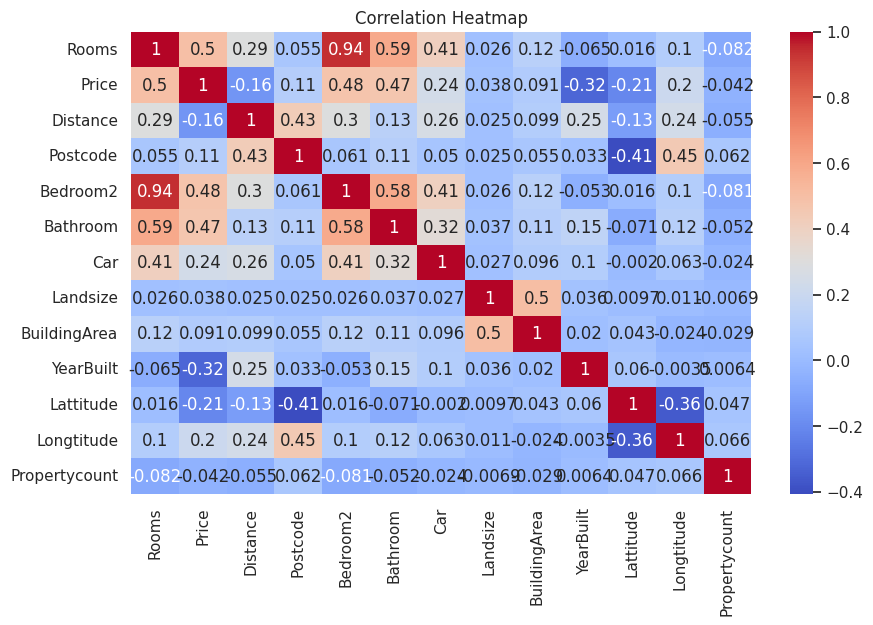

In [44]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt

# === 1. Load CSV from Path ===
file_path = "/content/melb_data.csv"  # Change if needed
df = pd.read_csv(file_path)

# === 2. Preview the Data ===
print("✅ Data Loaded — Preview:")
display(df.head())

# === 3. Bar Chart: Opportunities by Region ===
region_counts = df['Regionname'].value_counts().reset_index()
region_counts.columns = ['Region', 'Opportunity Count']
fig1 = px.bar(region_counts, x='Region', y='Opportunity Count',
              title='Top Regions with Investment Opportunities',
              color='Opportunity Count', color_continuous_scale='Blues')
fig1.show()

# === 4. Scatter Plot: Price vs Building Area ===
fig2 = px.scatter(df, x='BuildingArea', y='Price',
                  color='Regionname', size='Landsize',
                  hover_data=['Suburb'],
                  title='Large & Affordable Properties')
fig2.show()

# === 5. Histogram: Price Distribution ===
fig3 = px.histogram(df, x='Price', nbins=40, color='Regionname',
                    title='Price Range of Opportunity Properties')
fig3.show()

# === 6. Boxplot: Price by Region ===
fig4 = px.box(df, x='Regionname', y='Price',
              title='Price Distribution by Region',
              points='all')
fig4.show()

# === 7. Correlation Heatmap ===
plt.figure(figsize=(10, 6))
sns.heatmap(df.select_dtypes(include='number').corr(), annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap")
plt.show()




# plot treated KNN data

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



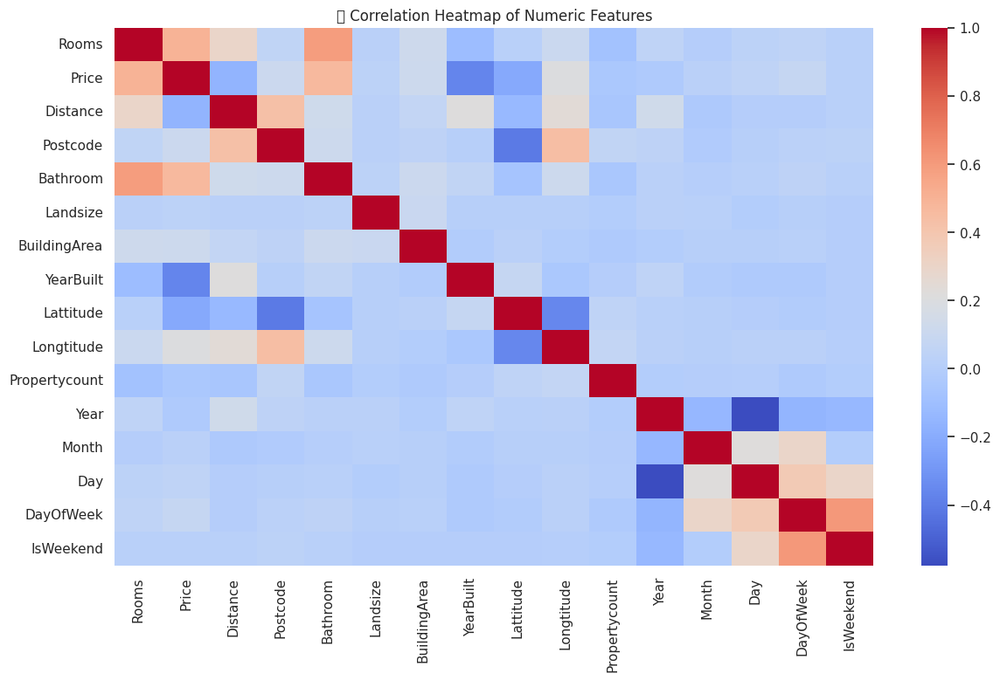

In [45]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

# === 1. Load the processed dataset ===
file_path = "/content/df_knn_treated.csv"  # <-- Change to your actual file path
df = pd.read_csv(file_path)

# === 2. Reconstruct Regionname from one-hot columns ===
region_cols = [col for col in df.columns if col.startswith('Regionname_')]
df['Regionname'] = df[region_cols].idxmax(axis=1).str.replace('Regionname_', '')

# === 3. Visualize Count of Opportunities by Region ===
region_counts = df['Regionname'].value_counts().reset_index()
region_counts.columns = ['Region', 'Opportunity Count']

fig1 = px.bar(region_counts, x='Region', y='Opportunity Count',
              color='Opportunity Count', title='📊 Opportunities Count by Region',
              color_continuous_scale='Blues')
fig1.show()

# === 4. Scatter Plot: Price vs Building Area ===
fig2 = px.scatter(df, x='BuildingArea', y='Price',
                  size='Landsize', color='Regionname',
                  hover_data=['Regionname'],
                  title='📍 Large & Affordable Properties by Region')
fig2.show()

# === 5. Histogram: Price Distribution ===
fig3 = px.histogram(df, x='Price', nbins=40, color='Regionname',
                    title='💰 Price Distribution Across Regions')
fig3.show()

# === 6. Boxplot: Price by Region ===
fig4 = px.box(df, x='Regionname', y='Price',
              title='📦 Price Range by Region (Boxplot)',
              points='all', color='Regionname')
fig4.show()

# === 7. Correlation Heatmap ===
plt.figure(figsize=(14, 8))
sns.heatmap(df.select_dtypes(include='number').corr(), cmap='coolwarm', annot=False)
plt.title("📈 Correlation Heatmap of Numeric Features")
plt.show()




# plot treated median data

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



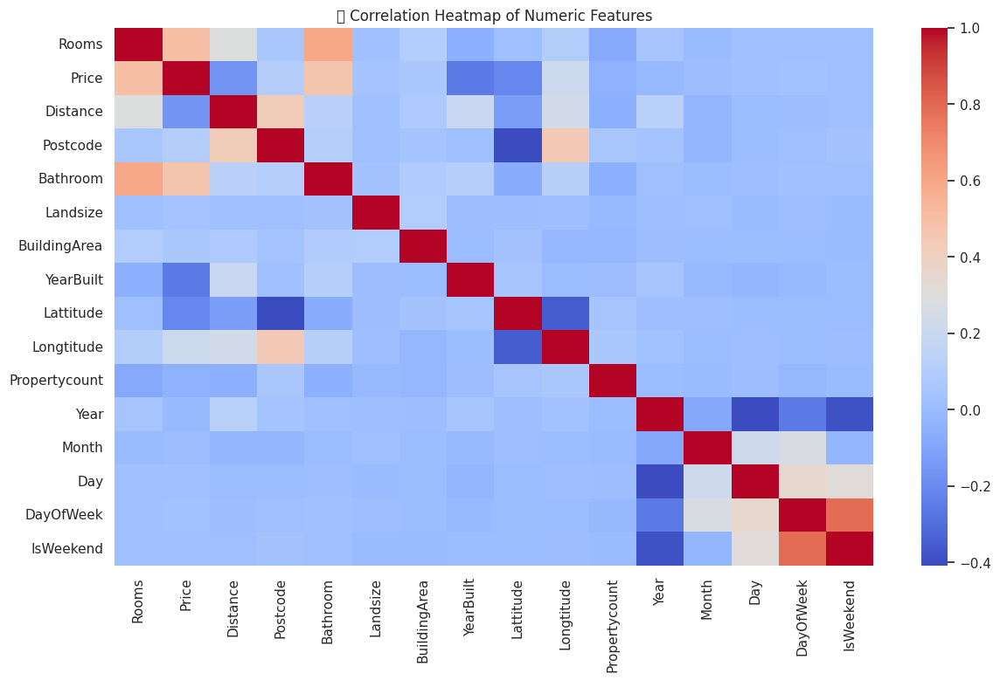

In [46]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

# === 1. Load the processed dataset ===
file_path = "/content/df_median_treated.csv"  # <-- Change to your actual file path
df = pd.read_csv(file_path)

# === 2. Reconstruct Regionname from one-hot columns ===
region_cols = [col for col in df.columns if col.startswith('Regionname_')]
df['Regionname'] = df[region_cols].idxmax(axis=1).str.replace('Regionname_', '')

# === 3. Visualize Count of Opportunities by Region ===
region_counts = df['Regionname'].value_counts().reset_index()
region_counts.columns = ['Region', 'Opportunity Count']

fig1 = px.bar(region_counts, x='Region', y='Opportunity Count',
              color='Opportunity Count', title='📊 Opportunities Count by Region',
              color_continuous_scale='Blues')
fig1.show()

# === 4. Scatter Plot: Price vs Building Area ===
fig2 = px.scatter(df, x='BuildingArea', y='Price',
                  size='Landsize', color='Regionname',
                  hover_data=['Regionname'],
                  title='📍 Large & Affordable Properties by Region')
fig2.show()

# === 5. Histogram: Price Distribution ===
fig3 = px.histogram(df, x='Price', nbins=40, color='Regionname',
                    title='💰 Price Distribution Across Regions')
fig3.show()

# === 6. Boxplot: Price by Region ===
fig4 = px.box(df, x='Regionname', y='Price',
              title='📦 Price Range by Region (Boxplot)',
              points='all', color='Regionname')
fig4.show()

# === 7. Correlation Heatmap ===
plt.figure(figsize=(14, 8))
sns.heatmap(df.select_dtypes(include='number').corr(), cmap='coolwarm', annot=False)
plt.title("📈 Correlation Heatmap of Numeric Features")
plt.show()


# mean treated dash board

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



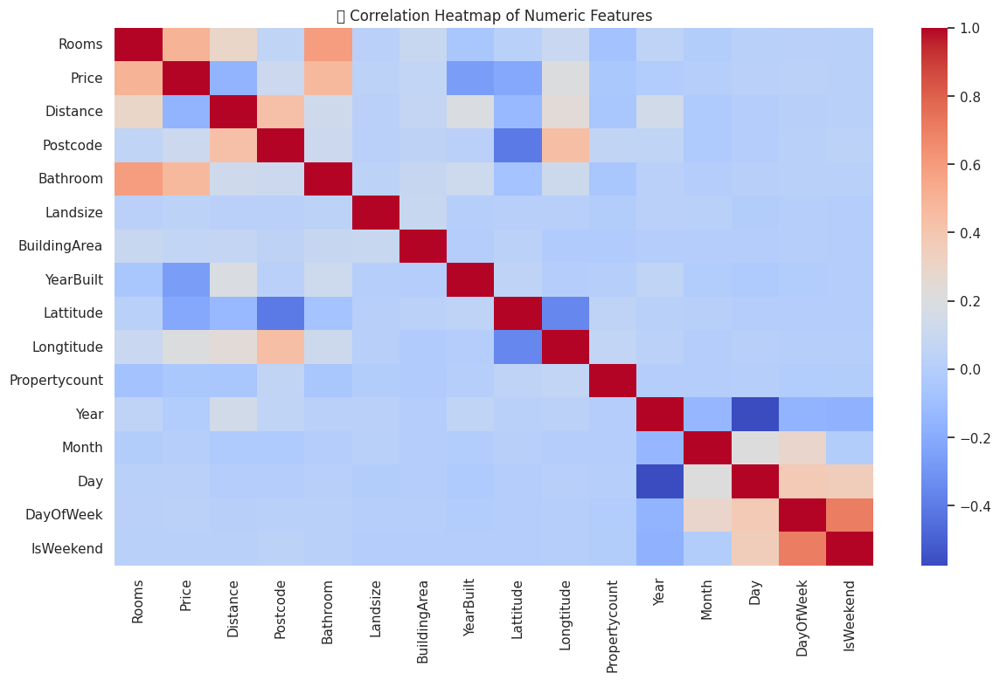

In [47]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

# === 1. Load the processed dataset ===
file_path = "/content/df_mean_treated.csv"  # <-- Change to your actual file path
df = pd.read_csv(file_path)

# === 2. Reconstruct Regionname from one-hot columns ===
region_cols = [col for col in df.columns if col.startswith('Regionname_')]
df['Regionname'] = df[region_cols].idxmax(axis=1).str.replace('Regionname_', '')

# === 3. Visualize Count of Opportunities by Region ===
region_counts = df['Regionname'].value_counts().reset_index()
region_counts.columns = ['Region', 'Opportunity Count']

fig1 = px.bar(region_counts, x='Region', y='Opportunity Count',
              color='Opportunity Count', title='📊 Opportunities Count by Region',
              color_continuous_scale='Blues')
fig1.show()

# === 4. Scatter Plot: Price vs Building Area ===
fig2 = px.scatter(df, x='BuildingArea', y='Price',
                  size='Landsize', color='Regionname',
                  hover_data=['Regionname'],
                  title='📍 Large & Affordable Properties by Region')
fig2.show()

# === 5. Histogram: Price Distribution ===
fig3 = px.histogram(df, x='Price', nbins=40, color='Regionname',
                    title='💰 Price Distribution Across Regions')
fig3.show()

# === 6. Boxplot: Price by Region ===
fig4 = px.box(df, x='Regionname', y='Price',
              title='📦 Price Range by Region (Boxplot)',
              points='all', color='Regionname')
fig4.show()

# === 7. Correlation Heatmap ===
plt.figure(figsize=(14, 8))
sns.heatmap(df.select_dtypes(include='number').corr(), cmap='coolwarm', annot=False)
plt.title("📈 Correlation Heatmap of Numeric Features")
plt.show()


# knn imputed dashboard

In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

# === 1. Load the processed dataset ===
file_path = "/content/melbourne_knn_imputed.csv"  # <-- Change to your actual file path
df = pd.read_csv(file_path)

# === 2. Reconstruct Regionname from one-hot columns ===
region_cols = [col for col in df.columns if col.startswith('Regionname_')]
df['Regionname'] = df[region_cols].idxmax(axis=1).str.replace('Regionname_', '')

# === 3. Visualize Count of Opportunities by Region ===
region_counts = df['Regionname'].value_counts().reset_index()
region_counts.columns = ['Region', 'Opportunity Count']

fig1 = px.bar(region_counts, x='Region', y='Opportunity Count',
              color='Opportunity Count', title='📊 Opportunities Count by Region',
              color_continuous_scale='Blues')
fig1.show()

# === 4. Scatter Plot: Price vs Building Area ===
fig2 = px.scatter(df, x='BuildingArea', y='Price',
                  size='Landsize', color='Regionname',
                  hover_data=['Regionname'],
                  title='📍 Large & Affordable Properties by Region')
fig2.show()

# === 5. Histogram: Price Distribution ===
fig3 = px.histogram(df, x='Price', nbins=40, color='Regionname',
                    title='💰 Price Distribution Across Regions')
fig3.show()

# === 6. Boxplot: Price by Region ===
fig4 = px.box(df, x='Regionname', y='Price',
              title='📦 Price Range by Region (Boxplot)',
              points='all', color='Regionname')
fig4.show()

# === 7. Correlation Heatmap ===
plt.figure(figsize=(14, 8))
sns.heatmap(df.select_dtypes(include='number').corr(), cmap='coolwarm', annot=False)
plt.title("📈 Correlation Heatmap of Numeric Features")
plt.show()


# msdian imputed dashboard

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



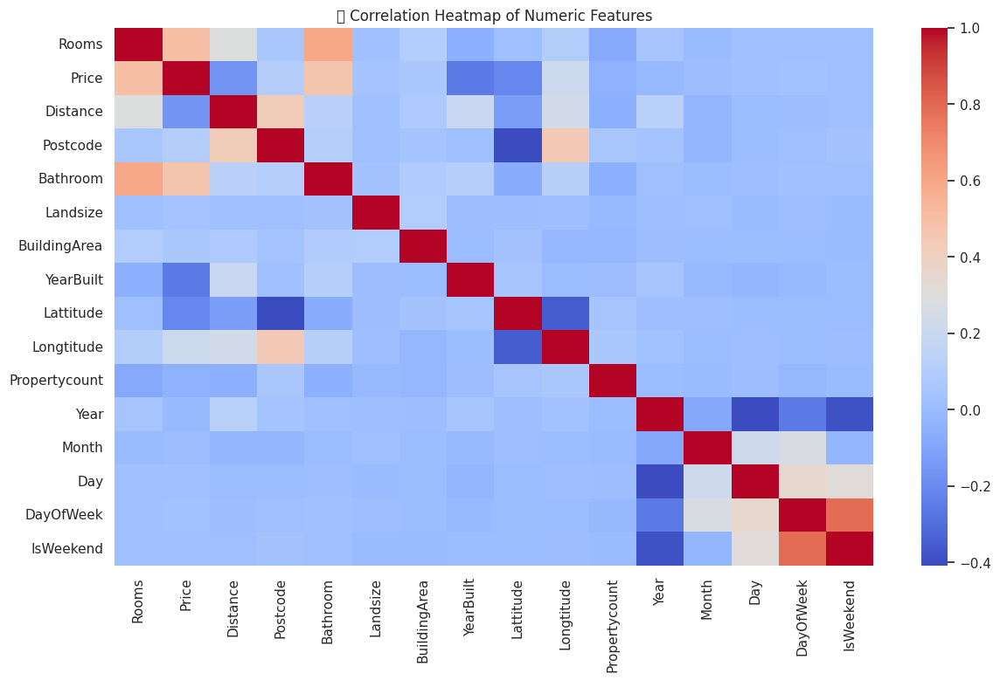

In [48]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

# === 1. Load the processed dataset ===
file_path = "/content/melbourne_median_imputed.csv"  # <-- Change to your actual file path
df = pd.read_csv(file_path)

# === 2. Reconstruct Regionname from one-hot columns ===
region_cols = [col for col in df.columns if col.startswith('Regionname_')]
df['Regionname'] = df[region_cols].idxmax(axis=1).str.replace('Regionname_', '')

# === 3. Visualize Count of Opportunities by Region ===
region_counts = df['Regionname'].value_counts().reset_index()
region_counts.columns = ['Region', 'Opportunity Count']

fig1 = px.bar(region_counts, x='Region', y='Opportunity Count',
              color='Opportunity Count', title='📊 Opportunities Count by Region',
              color_continuous_scale='Blues')
fig1.show()

# === 4. Scatter Plot: Price vs Building Area ===
fig2 = px.scatter(df, x='BuildingArea', y='Price',
                  size='Landsize', color='Regionname',
                  hover_data=['Regionname'],
                  title='📍 Large & Affordable Properties by Region')
fig2.show()

# === 5. Histogram: Price Distribution ===
fig3 = px.histogram(df, x='Price', nbins=40, color='Regionname',
                    title='💰 Price Distribution Across Regions')
fig3.show()

# === 6. Boxplot: Price by Region ===
fig4 = px.box(df, x='Regionname', y='Price',
              title='📦 Price Range by Region (Boxplot)',
              points='all', color='Regionname')
fig4.show()

# === 7. Correlation Heatmap ===
plt.figure(figsize=(14, 8))
sns.heatmap(df.select_dtypes(include='number').corr(), cmap='coolwarm', annot=False)
plt.title("📈 Correlation Heatmap of Numeric Features")
plt.show()


# mean imputed dashboard

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



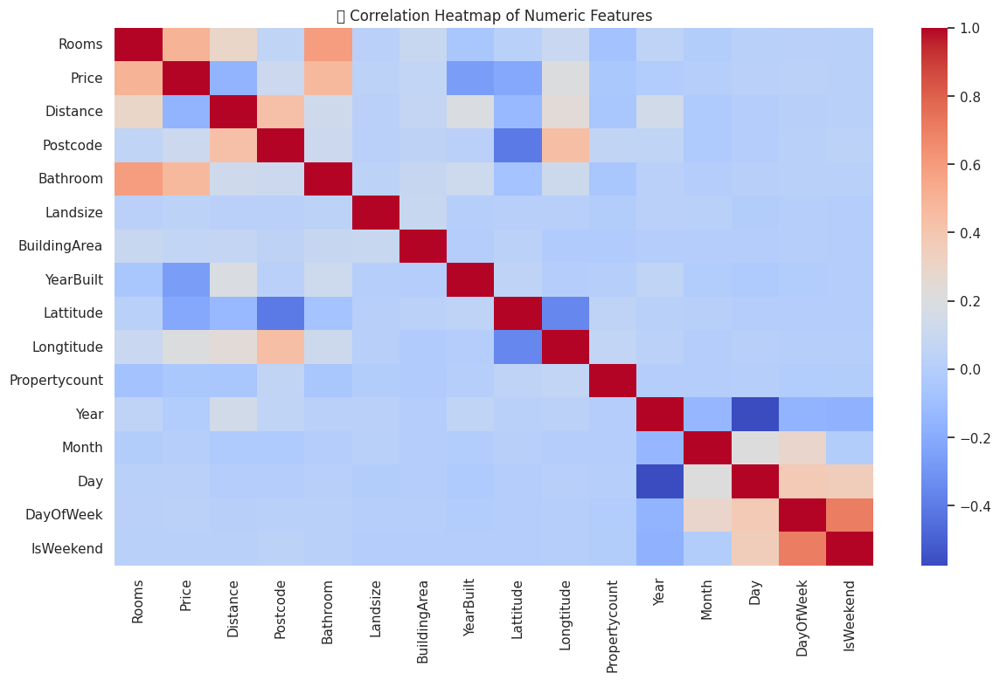

In [49]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

# === 1. Load the processed dataset ===
file_path = "/content/melbourne_mean_imputed.csv"  # <-- Change to your actual file path
df = pd.read_csv(file_path)

# === 2. Reconstruct Regionname from one-hot columns ===
region_cols = [col for col in df.columns if col.startswith('Regionname_')]
df['Regionname'] = df[region_cols].idxmax(axis=1).str.replace('Regionname_', '')

# === 3. Visualize Count of Opportunities by Region ===
region_counts = df['Regionname'].value_counts().reset_index()
region_counts.columns = ['Region', 'Opportunity Count']

fig1 = px.bar(region_counts, x='Region', y='Opportunity Count',
              color='Opportunity Count', title='📊 Opportunities Count by Region',
              color_continuous_scale='Blues')
fig1.show()

# === 4. Scatter Plot: Price vs Building Area ===
fig2 = px.scatter(df, x='BuildingArea', y='Price',
                  size='Landsize', color='Regionname',
                  hover_data=['Regionname'],
                  title='📍 Large & Affordable Properties by Region')
fig2.show()

# === 5. Histogram: Price Distribution ===
fig3 = px.histogram(df, x='Price', nbins=40, color='Regionname',
                    title='💰 Price Distribution Across Regions')
fig3.show()

# === 6. Boxplot: Price by Region ===
fig4 = px.box(df, x='Regionname', y='Price',
              title='📦 Price Range by Region (Boxplot)',
              points='all', color='Regionname')
fig4.show()

# === 7. Correlation Heatmap ===
plt.figure(figsize=(14, 8))
sns.heatmap(df.select_dtypes(include='number').corr(), cmap='coolwarm', annot=False)
plt.title("📈 Correlation Heatmap of Numeric Features")
plt.show()


In [54]:
import pandas as pd

# Load your KNN-treated and scaled dataset
df = pd.read_csv("/content/melb_data.csv")  # Change path if needed

# Set thresholds
area_threshold = df['BuildingArea'].quantile(0.75)   # Top 25% building area
price_threshold = df['Price'].quantile(0.25)         # Bottom 25% price

# Filter for opportunities
high_area_low_price = df[(df['BuildingArea'] > area_threshold) & (df['Price'] < price_threshold)]

# Show results
print(f"Total listings with large area and low price: {len(high_area_low_price)}")
high_area_low_price.head(10)

Total listings with large area and low price: 82


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
141,Altona,158 Queen St,3,h,520000.0,VB,Greg,3/09/2016,13.8,3018.0,...,2.0,1.0,352.0,242.0,2015.0,Hobsons Bay,-37.8700,144.8250,Western Metropolitan,5301.0
2830,Glen Iris,1/58 Edgar St N,2,t,600000.0,VB,Gary,22/08/2016,9.2,3146.0,...,1.0,1.0,0.0,1143.0,NaN,Stonnington,-37.8506,145.0465,Southern Metropolitan,10412.0
2943,Glenroy,165 Hilton St,4,h,630000.0,S,Stockdale,27/11/2016,13.0,3046.0,...,2.0,2.0,602.0,180.0,1950.0,Moreland,-37.7005,144.9258,Northern Metropolitan,8870.0
2953,Glenroy,33 View St,4,h,638000.0,S,Barry,30/07/2016,13.0,3046.0,...,2.0,1.0,624.0,258.0,2005.0,Moreland,-37.6969,144.9334,Northern Metropolitan,8870.0
3258,Heidelberg Heights,3/17 Burns Ct,3,h,600000.0,VB,Fletchers,22/08/2016,10.5,3081.0,...,2.0,2.0,251.0,200.0,2012.0,Banyule,-37.7358,145.0559,Eastern Metropolitan,2947.0
3426,Kealba,128 Driscolls Rd,3,h,582000.0,SP,Brad,16/07/2016,15.0,3021.0,...,2.0,4.0,530.0,186.0,1980.0,Brimbank,-37.7375,144.8282,Western Metropolitan,1202.0
3733,Maidstone,3/20 Burns St,3,u,520000.0,PI,Burnham,10/12/2016,9.2,3012.0,...,2.0,2.0,184.0,184.0,NaN,Maribyrnong,-37.7868,144.8772,Western Metropolitan,3873.0
3964,Maribyrnong,110/44 Skyline Dr,2,u,570000.0,PI,McDonald,27/11/2016,8.7,3032.0,...,2.0,1.0,3014.0,204.0,2012.0,Maribyrnong,-37.7853,144.8944,Western Metropolitan,4918.0
5058,Reservoir,1/1 Leamington St,3,h,625000.0,PI,Barry,7/05/2016,11.2,3073.0,...,2.0,1.0,267.0,186.0,2003.0,Darebin,-37.7132,145.0075,Northern Metropolitan,21650.0
6043,Sunshine North,35 Furlong Rd,3,h,591000.0,S,First,22/05/2016,13.3,3020.0,...,1.0,2.0,673.0,673.0,1970.0,Brimbank,-37.7623,144.8272,Western Metropolitan,4217.0


# high building area in low price

In [51]:
import pandas as pd

# Load your KNN-treated and scaled dataset
df = pd.read_csv("/content/knn_outliers_removed_scaled.csv")  # Change path if needed

# Set thresholds
area_threshold = df['BuildingArea'].quantile(0.75)   # Top 25% building area
price_threshold = df['Price'].quantile(0.25)         # Bottom 25% price

# Filter for opportunities
high_area_low_price = df[(df['BuildingArea'] > area_threshold) & (df['Price'] < price_threshold)]

# Show results
print(f"Total listings with large area and low price: {len(high_area_low_price)}")
high_area_low_price.head(10)


Total listings with large area and low price: 131


,Rooms,Price,Distance,Postcode,Bathroom,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,...,CouncilArea_Wyndham,CouncilArea_Yarra,CouncilArea_Yarra Ranges,Regionname_Eastern Victoria,Regionname_Northern Metropolitan,Regionname_Northern Victoria,Regionname_South-Eastern Metropolitan,Regionname_Southern Metropolitan,Regionname_Western Metropolitan,Regionname_Western Victoria
141,3.0,520000.0,13.8,3018.0,2.0,352.0,242.0,2015.0,-37.8700,144.8250,...,False,False,False,False,False,False,False,False,True,False
211,3.0,590000.0,11.1,3025.0,1.0,561.0,206.4,1989.2,-37.8444,144.8491,...,False,False,False,False,False,False,False,False,True,False
1992,2.0,599000.0,7.8,3058.0,2.0,76.0,313.6,1995.6,-37.7474,144.9621,...,False,False,False,False,True,False,False,False,False,False
2279,2.0,582500.0,7.7,3184.0,1.0,0.0,249.8,1985.2,-37.8850,144.9910,...,False,False,False,False,False,False,False,True,False,False
2830,2.0,600000.0,9.2,3146.0,1.0,0.0,1143.0,1986.2,-37.8506,145.0465,...,False,False,False,False,False,False,False,True,False,False
2884,3.0,575500.0,13.0,3046.0,1.0,701.0,208.7,1985.8,-37.6953,144.9397,...,False,False,False,False,True,False,False,False,False,False
2914,3.0,577000.0,13.0,3046.0,1.0,706.0,208.7,1972.8,-37.7053,144.9372,...,False,False,False,False,True,False,False,False,False,False
2943,4.0,630000.0,13.0,3046.0,2.0,602.0,180.0,1950.0,-37.7005,144.9258,...,False,False,False,False,True,False,False,False,False,False
2953,4.0,638000.0,13.0,3046.0,2.0,624.0,258.0,2005.0,-37.6969,144.9334,...,False,False,False,False,True,False,False,False,False,False
3122,2.0,600000.0,4.6,3122.0,1.0,0.0,309.6,1996.4,-37.8160,145.0272,...,False,False,False,False,False,False,False,True,False,False


# List of target properties

In [52]:
import pandas as pd

# Load the preprocessed dataset
df = pd.read_csv("/content/df_knn_treated.csv")  # Change path if needed

# Identify columns corresponding to target regions
target_regions = [
    'Regionname_Western Metropolitan',
    'Regionname_South-Eastern Metropolitan'
]

# Ensure those columns exist
missing = [col for col in target_regions if col not in df.columns]
if missing:
    print("Missing columns:", missing)
else:
    # Filter rows where either region column is 1
    filtered_df = df[(df['Regionname_Western Metropolitan'] == 1) |
                     (df['Regionname_South-Eastern Metropolitan'] == 1)]

    # Show filtered results
    print(f"Total properties in target investment regions: {len(filtered_df)}")
    display(filtered_df.head(10))


Total properties in target investment regions: 3398


,Rooms,Price,Distance,Postcode,Bathroom,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,...,CouncilArea_Wyndham,CouncilArea_Yarra,CouncilArea_Yarra Ranges,Regionname_Eastern Victoria,Regionname_Northern Metropolitan,Regionname_Northern Victoria,Regionname_South-Eastern Metropolitan,Regionname_Southern Metropolitan,Regionname_Western Metropolitan,Regionname_Western Victoria
38,3.0,840000.0,13.5,3042.0,2.0,303.0,225.0,2016.0,-37.7180,144.8780,...,False,False,False,False,False,False,False,False,True,False
39,3.0,730000.0,13.5,3042.0,2.0,0.0,145.0,1965.0,-37.7203,144.8755,...,False,False,False,False,False,False,False,False,True,False
40,3.0,770000.0,13.5,3042.0,2.0,0.0,145.0,1965.0,-37.7203,144.8755,...,False,False,False,False,False,False,False,False,True,False
41,2.0,603000.0,13.5,3042.0,1.0,272.0,84.0,1950.0,-37.7294,144.8880,...,False,False,False,False,False,False,False,False,True,False
42,3.0,700000.0,13.5,3042.0,2.0,239.0,134.0,2009.0,-37.7218,144.8837,...,False,False,False,False,False,False,False,False,True,False
43,3.0,600000.0,13.5,3042.0,1.0,290.0,116.0,1980.0,-37.7273,144.8744,...,False,False,False,False,False,False,False,False,True,False
44,2.0,500000.0,13.5,3042.0,1.0,168.0,86.0,2011.0,-37.7215,144.8864,...,False,False,False,False,False,False,False,False,True,False
45,3.0,720000.0,13.5,3042.0,1.0,620.0,129.8,1976.6,-37.7173,144.8872,...,False,False,False,False,False,False,False,False,True,False
46,4.0,785000.0,13.5,3042.0,1.0,597.0,127.0,1976.4,-37.7259,144.8792,...,False,False,False,False,False,False,False,False,True,False
47,6.0,725000.0,13.5,3042.0,3.0,976.0,186.0,1980.0,-37.7239,144.8735,...,False,False,False,False,False,False,False,False,True,False


In [58]:
import pandas as pd


# Load the preprocessed dataset
df = pd.read_csv("/content/melb_data.csv")  # Change path if needed

# 1. Predict probability of being a Good Investment (class = 1)
y_prob = model.predict_proba(X_test)[:, 1]  # Confidence for class 1 (GoodInvestment)

# 2. Add predictions back to test set
review_df = X_test.copy()
review_df['Predicted_Probability'] = y_prob
review_df['Predicted_Label'] = model.predict(X_test)
review_df['Actual_Label'] = y_test.values

# 3. Sort by highest predicted probability
shortlisted = review_df.sort_values(by='Predicted_Probability', ascending=False)

# 4. Take top N properties for manual review (e.g., top 50)
top_n = 50
top_properties = shortlisted.head(top_n)

# 5. Show and optionally save
print(f"✅ Top {top_n} properties shortlisted for review:")
display(top_properties[['Predicted_Probability', 'Predicted_Label', 'Actual_Label']].head(10))

# Save to CSV
top_properties.to_csv("top_predicted_investments.csv", index=False)
print("📁 Saved to: top_predicted_investments.csv")

✅ Top 50 properties shortlisted for review:


,Predicted_Probability,Predicted_Label,Actual_Label
6778,0.999994,1,1
647,0.982105,1,1
1368,0.981087,1,1
251,0.977916,1,1
8793,0.974039,1,1
2864,0.969965,1,1
5556,0.969834,1,0
1489,0.969644,1,1
379,0.968821,1,1
3082,0.959995,1,0


📁 Saved to: top_predicted_investments.csv


In [53]:
import pandas as pd


# Load the preprocessed dataset
df = pd.read_csv("/content/df_knn_treated.csv")  # Change path if needed

# 1. Predict probability of being a Good Investment (class = 1)
y_prob = model.predict_proba(X_test)[:, 1]  # Confidence for class 1 (GoodInvestment)

# 2. Add predictions back to test set
review_df = X_test.copy()
review_df['Predicted_Probability'] = y_prob
review_df['Predicted_Label'] = model.predict(X_test)
review_df['Actual_Label'] = y_test.values

# 3. Sort by highest predicted probability
shortlisted = review_df.sort_values(by='Predicted_Probability', ascending=False)

# 4. Take top N properties for manual review (e.g., top 50)
top_n = 50
top_properties = shortlisted.head(top_n)

# 5. Show and optionally save
print(f"✅ Top {top_n} properties shortlisted for review:")
display(top_properties[['Predicted_Probability', 'Predicted_Label', 'Actual_Label']].head(10))

# Save to CSV
top_properties.to_csv("top_predicted_investments.csv", index=False)
print("📁 Saved to: top_predicted_investments.csv")


✅ Top 50 properties shortlisted for review:


,Predicted_Probability,Predicted_Label,Actual_Label
6778,0.999994,1,1
647,0.982105,1,1
1368,0.981087,1,1
251,0.977916,1,1
8793,0.974039,1,1
2864,0.969965,1,1
5556,0.969834,1,0
1489,0.969644,1,1
379,0.968821,1,1
3082,0.959995,1,0


📁 Saved to: top_predicted_investments.csv
Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.


/tmp/ipython-input-59-813828855.py:29: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipython-input-59-813828855.py:33: UserWarning:

Glyph 127960 (\N{HOUSE BUILDINGS}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 127960 (\N{HOUSE BUILDINGS}) missing from font(s) DejaVu Sans.



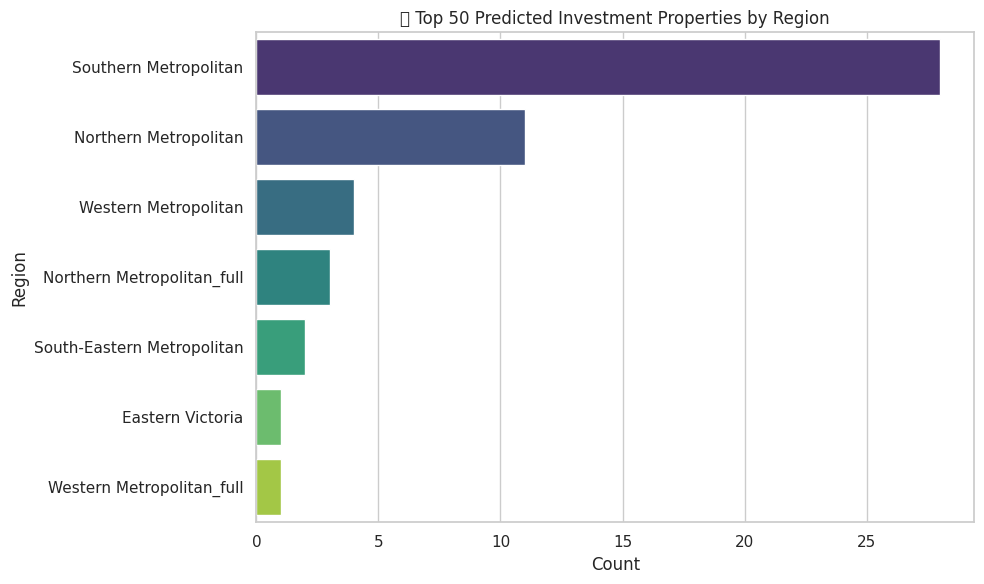

/tmp/ipython-input-59-813828855.py:42: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.



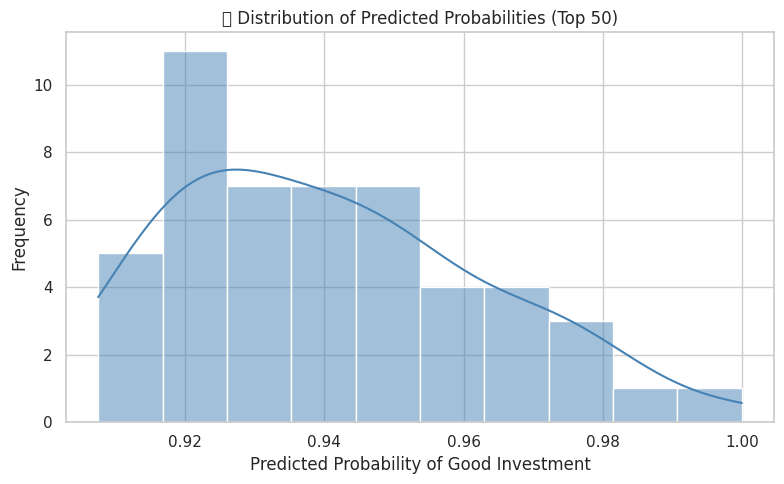

In [59]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Load the top 50 predicted investments
top_properties = pd.read_csv("/content/top_predicted_investments.csv")

# Step 2: Re-load the full dataset to match Regionname with top 50 listings
# ⚠️ Make sure this file exists in your environment
full_data = pd.read_csv("/content/df_knn_treated.csv")

# Step 3: Merge top 50 with region columns
top_properties = top_properties.merge(full_data, left_index=True, right_index=True, suffixes=('', '_full'))

# Step 4: Identify region columns (they start with 'Regionname_')
region_cols = [col for col in top_properties.columns if col.startswith("Regionname_")]

# Step 5: For each row, find the region that has value = 1
def extract_region(row):
    for col in region_cols:
        if row[col] == 1:
            return col.replace("Regionname_", "")
    return "Unknown"

top_properties["Region"] = top_properties.apply(extract_region, axis=1)

# Step 6: Plot bar chart of region counts in top 50
plt.figure(figsize=(10, 6))
sns.countplot(data=top_properties, y="Region", order=top_properties["Region"].value_counts().index, palette="viridis")
plt.title("🏘️ Top 50 Predicted Investment Properties by Region")
plt.xlabel("Count")
plt.ylabel("Region")
plt.tight_layout()
plt.show()

# Step 7: Plot histogram of predicted probabilities
plt.figure(figsize=(8, 5))
sns.histplot(top_properties["Predicted_Probability"], bins=10, kde=True, color="steelblue")
plt.title("📈 Distribution of Predicted Probabilities (Top 50)")
plt.xlabel("Predicted Probability of Good Investment")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()
